In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
sys.path.append(os.path.expanduser('~/rds/rds-dsk-lab-eWkDxBhxBrQ/dimorl/code/mopo'))

In [23]:
from collections import namedtuple

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from dogo.results import get_sac_pools, get_experiment_details, PoolArrs
from dogo.rollouts.split import split_halfcheetah_v2_trans_arr
from dogo.visualisation.model_pool_plotting import (
    model_pool_visitation_2dhist,
    model_pool_pen_rewards_2dhist,
    model_pool_unpen_rewards_2dhist,
    model_pool_penalties_2dhist,
    model_pool_rmse_2dhist
)

In [4]:
cols = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']

In [5]:
EXP_LIST = [
    # No REx - MOPO Pen 0 - Rollout Length 5
    "MP919",
    "MP920",
    "MP921",
    # REx 5 - MOPO Pen 0 - Rollout Length 5
    "MP922",
    "MP923",
    "MP924",
    # REx 10 - MOPO Pen 0 - Rollout Length 5
    "MP925",
    "MP926",
    "MP927",
    # No REx - MOPO Pen 1 - Rollout Length 5
    "MP781",
    "MP782",
    "MP783",
    # REx 5 - MOPO Pen 1 - Rollout Length 5
    "MP793",
    "MP794",
    "MP795",
    # REx 10 - MOPO Pen 1 - Rollout Length 5
    "MP790",
    "MP791",
    "MP792",
    # No REx - MOPO Pen 5 - Rollout Length 5
    "MP796",
    "MP797",
    "MP798",
    # REx 5 - MOPO Pen 5 - Rollout Length 5
    "MP802",
    "MP803",
    "MP804",
    # REx 10 - MOPO Pen 5 - Rollout Length 5
    "MP799",
    "MP800",
    "MP801",
    # No REx - MOPO Pen 5 - Rollout Length 10
    "MP817",
    "MP818",
    "MP819",
    # REx 5 - MOPO Pen 5 - Rollout Length 10
    "MP823",
    "MP824",
    "MP825",
    # REx 10 - MOPO Pen 5 - Rollout Length 10
    "MP820",
    "MP821",
    "MP822",
    # No REx - MOPO Pen 5 - Rollout Length 10 - 1 Retrain Epoch
    "MP862",
    "MP863",
    "MP864",
    # REx 10 - MOPO Pen 5 - Rollout Length 10 - 1 Retrain Epoch
    "MP865",
    "MP866",
    "MP867",
    # No REx - MOPO Pen 5 - Rollout Length 10 - Original Model
    "MP868",
    "MP869",
    "MP870",
    # REx 10 - MOPO Pen 5 - Rollout Length 10 - Original Model
    "MP871",
    "MP872",
    "MP873",
]
training_results = {}
for exp in EXP_LIST:
    # print(exp)
    training_results[exp] = PoolArrs(*get_sac_pools(exp))

# Pool Analysis

In [7]:
min_angle = +np.inf
max_angle = -np.inf
for exp in EXP_LIST:
    obs, _, next_obs, _, _, _, _ = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    min_angle = min(min_angle, obs[:,1:8].min())#, next_obs[:,1:8].min())
    max_angle = max(max_angle, obs[:,1:8].max())#, next_obs[:,1:8].max())
min_angle, max_angle

(-3.14139, 3.1415484)

# Reward Histograms

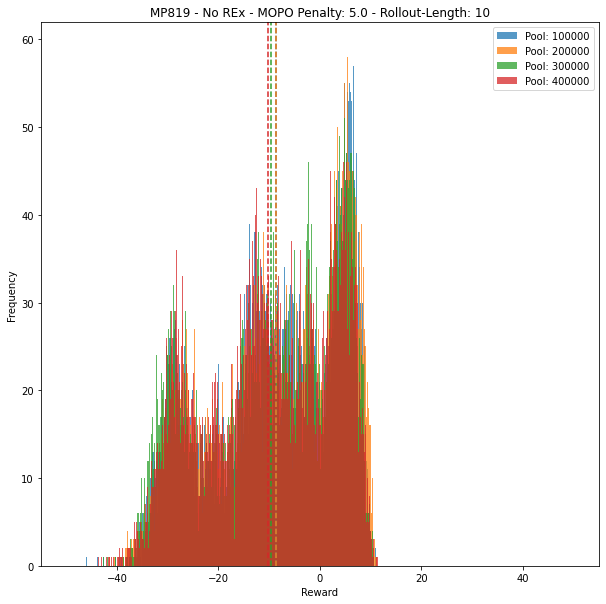

In [9]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))

exp = 'MP819'
for i, pool_id in enumerate(range(100000,500000,100000)):
    pool, _, _, _, _ = get_sac_pools(exp, pool=str(pool_id))
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(pool)
    ax.hist(rew, bins=np.linspace(-50,50,1000), color=cols[i], alpha=0.75, label=f'Pool: {pool_id}')
    ax.axvline(rew.mean(), color=cols[i], ls='--')
ax.set_xlabel('Reward')
ax.set_ylabel('Frequency')
ax.set_title(f'{exp} - No REx - MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.legend()

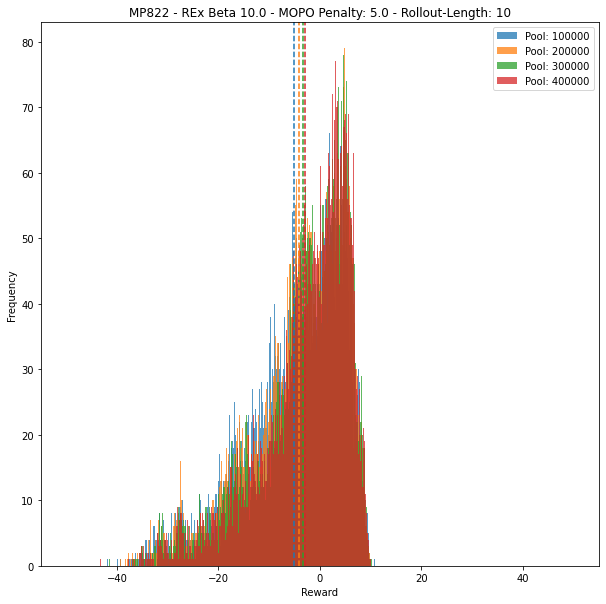

In [10]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))

exp = 'MP822'
for i, pool_id in enumerate(range(100000,500000,100000)):
    pool, _, _, _, _ = get_sac_pools(exp, pool=str(pool_id))
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(pool)
    ax.hist(rew, bins=np.linspace(-50,50,1000), color=cols[i], alpha=0.75, label=f'Pool: {pool_id}')
    ax.axvline(rew.mean(), color=cols[i], ls='--')
ax.set_xlabel('Reward')
ax.set_ylabel('Frequency')
ax.set_title(f'{exp} - REx Beta 10.0 - MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.legend()

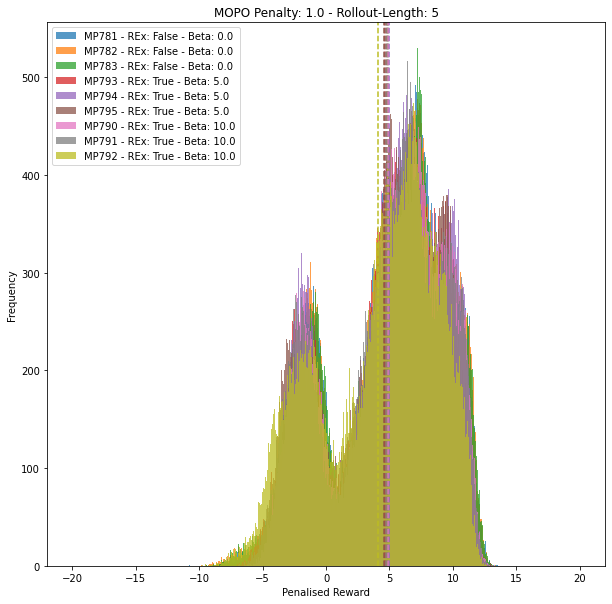

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP781", False, 0.0),
    ("MP782", False, 0.0),
    ("MP783", False, 0.0),
    ("MP793", True, 5.0),
    ("MP794", True, 5.0),
    ("MP795", True, 5.0),
    ("MP790", True, 10.0),
    ("MP791", True, 10.0),
    ("MP792", True, 10.0),
]):
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.hist(rew, bins=np.linspace(-20,20,1000), color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(rew.mean(), color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 1.0 - Rollout-Length: 5')
ax.set_xlabel('Penalised Reward')
ax.set_ylabel('Frequency')
ax.legend(loc='upper left')

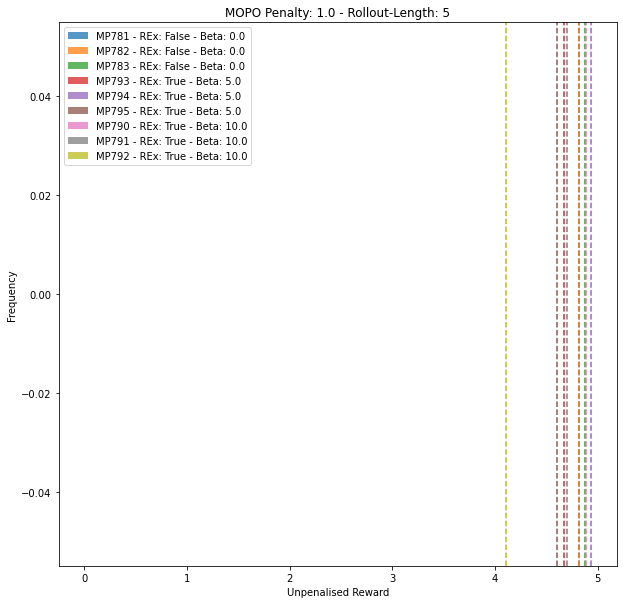

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP781", False, 0.0),
    ("MP782", False, 0.0),
    ("MP783", False, 0.0),
    ("MP793", True, 5.0),
    ("MP794", True, 5.0),
    ("MP795", True, 5.0),
    ("MP790", True, 10.0),
    ("MP791", True, 10.0),
    ("MP792", True, 10.0),
]):
    _, _, _, rew, _, _, pen = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.hist(rew+pen, color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(rew.mean(), color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 1.0 - Rollout-Length: 5')
ax.set_xlabel('Unpenalised Reward')
ax.set_ylabel('Frequency')
ax.legend(loc='upper left')

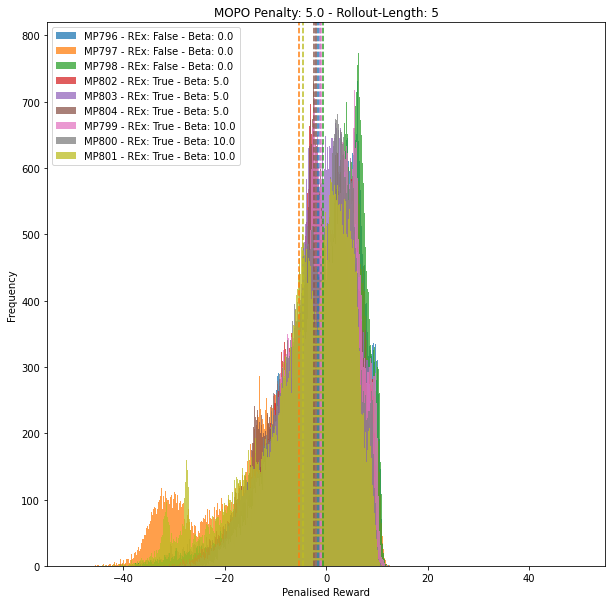

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP796", False, 0.0),
    ("MP797", False, 0.0),
    ("MP798", False, 0.0),
    ("MP802", True, 5.0),
    ("MP803", True, 5.0),
    ("MP804", True, 5.0),
    ("MP799", True, 10.0),
    ("MP800", True, 10.0),
    ("MP801", True, 10.0),
]):
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.hist(rew, bins=np.linspace(-50,50,1000), color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(rew.mean(), color=cols[i], ls='--')
ax.set_xlabel('Penalised Reward')
ax.set_ylabel('Frequency')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 5')
ax.legend(loc='upper left')

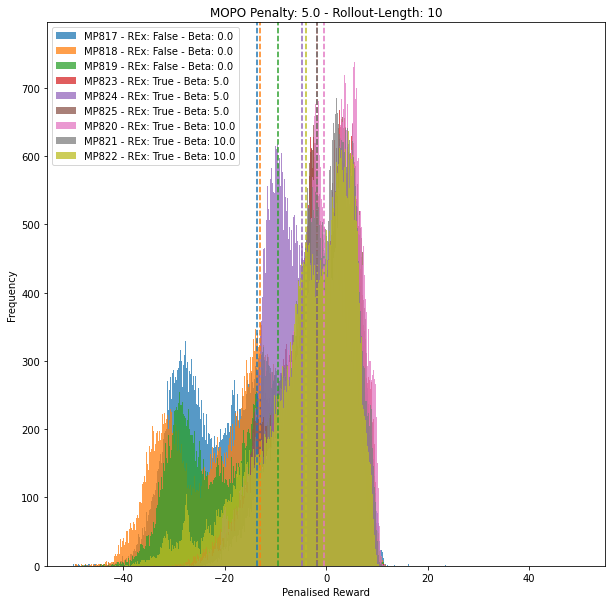

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP817", False, 0.0),
    ("MP818", False, 0.0),
    ("MP819", False, 0.0),
    ("MP823", True, 5.0),
    ("MP824", True, 5.0),
    ("MP825", True, 5.0),
    ("MP820", True, 10.0),
    ("MP821", True, 10.0),
    ("MP822", True, 10.0),
]):
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.hist(rew, bins=np.linspace(-50,50,1000), color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(rew.mean(), color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Penalised Reward')
ax.set_ylabel('Frequency')
ax.legend(loc='upper left')

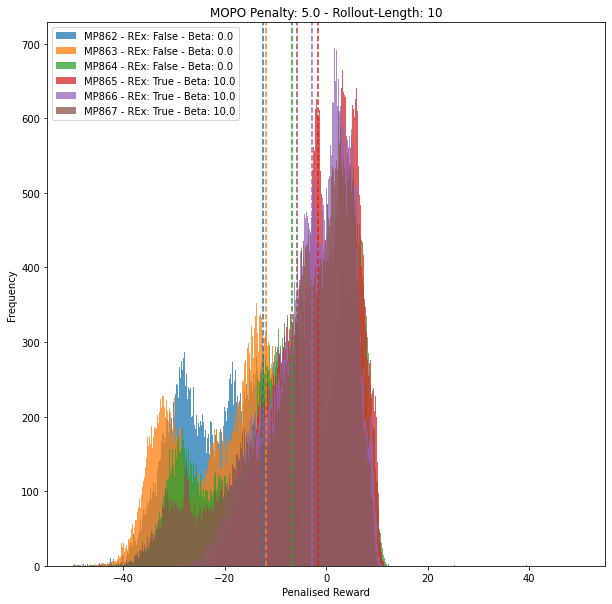

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.hist(rew, bins=np.linspace(-50,50,1000), color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(rew.mean(), color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Penalised Reward')
ax.set_ylabel('Frequency')
ax.legend(loc='upper left')

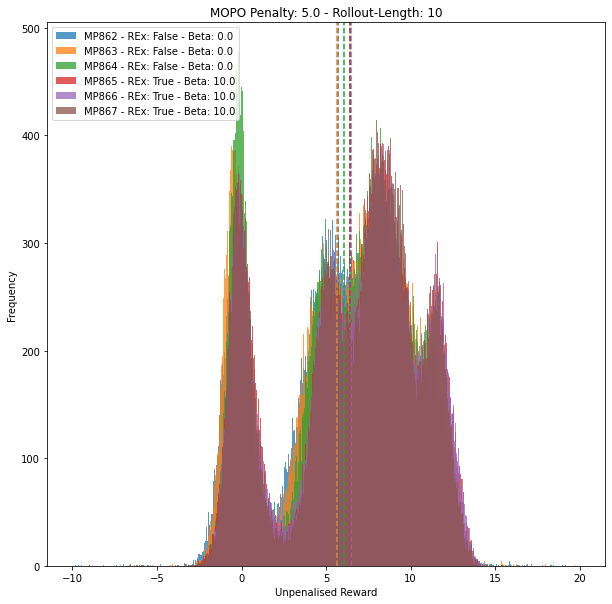

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    _, _, _, rew, _, _, pen = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.hist(rew+5*pen, bins=np.linspace(-10,20,1000), color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline((rew+5*pen).mean(), color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Unpenalised Reward')
ax.set_ylabel('Frequency')
ax.legend(loc='upper left')

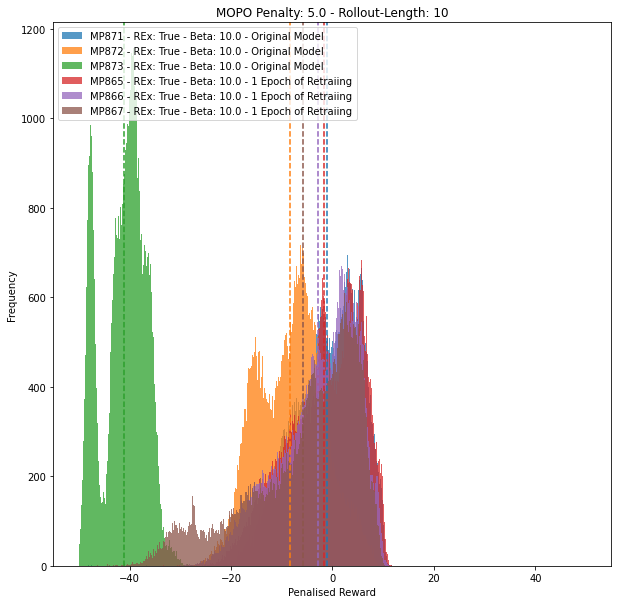

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP871", True, "10.0 - Original Model"),
    ("MP872", True, "10.0 - Original Model"),
    ("MP873", True, "10.0 - Original Model"),
    ("MP865", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP866", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP867", True, "10.0 - 1 Epoch of Retraiing"),
]):
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.hist(rew, bins=np.linspace(-50,50,1000), color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(rew.mean(), color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Penalised Reward')
ax.set_ylabel('Frequency')
ax.legend(loc='upper left')

# Penalty Histograms

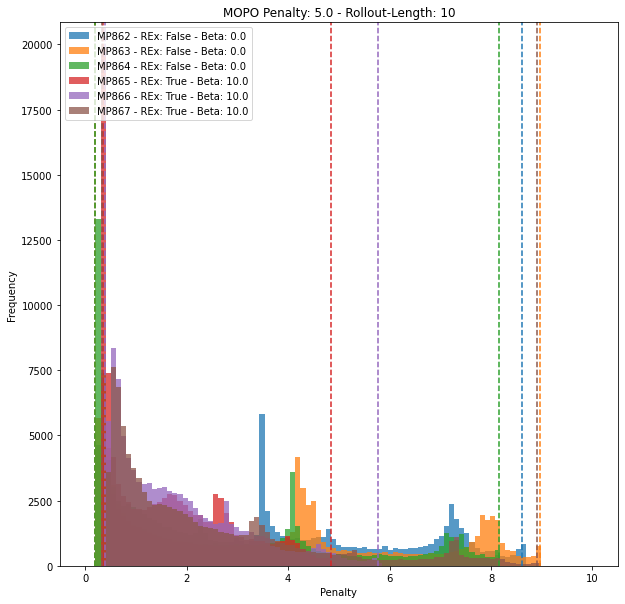

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, _, _, _, pens = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.hist(pens, bins=np.linspace(0,10,100), color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(exp_details.min_penalty, color=cols[i], ls='--')
    ax.axvline(exp_details.max_penalty, color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Penalty')
ax.set_ylabel('Frequency')
ax.legend(loc='upper left')

Text(0, 0.5, 'Penalty')

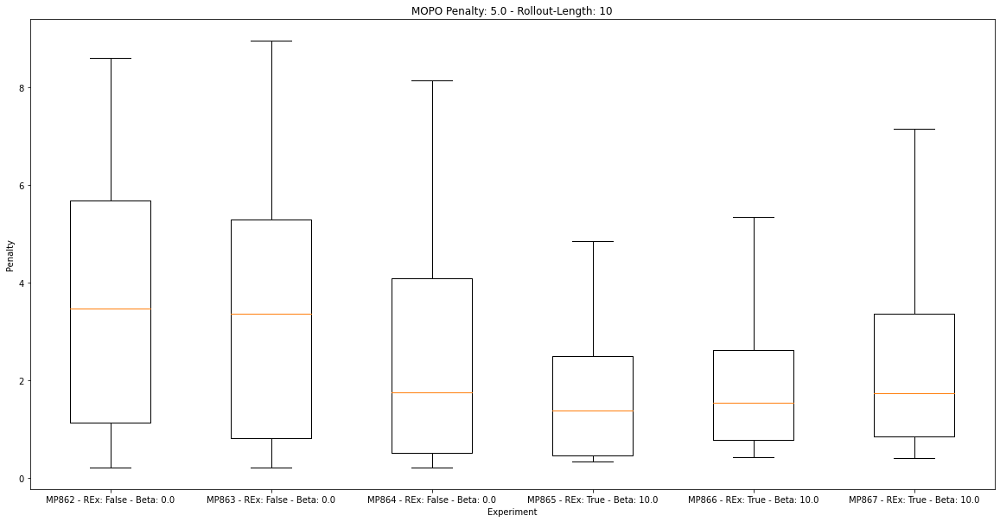

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20,10))

labels = []
pens_arrs = []
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    labels.append(f'{exp} - REx: {rex} - Beta: {beta}')
    exp_details = get_experiment_details(exp)
    _, _, _, _, _, _, pens = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    pens_arrs.append(pens.flatten())

ax.boxplot(pens_arrs, showfliers=False, labels=labels)

ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Experiment')
ax.set_ylabel('Penalty')
# ax.set_ylim(-0.01,0.35)

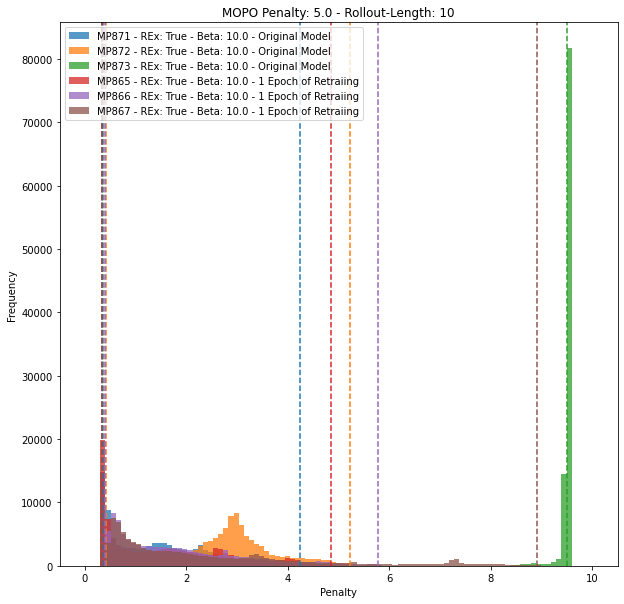

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP871", True, "10.0 - Original Model"),
    ("MP872", True, "10.0 - Original Model"),
    ("MP873", True, "10.0 - Original Model"),
    ("MP865", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP866", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP867", True, "10.0 - 1 Epoch of Retraiing"),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, _, _, _, pens = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.hist(pens, bins=np.linspace(0,10,100), color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(exp_details.min_penalty, color=cols[i], ls='--')
    ax.axvline(exp_details.max_penalty, color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Penalty')
ax.set_ylabel('Frequency')
ax.legend(loc='upper left')

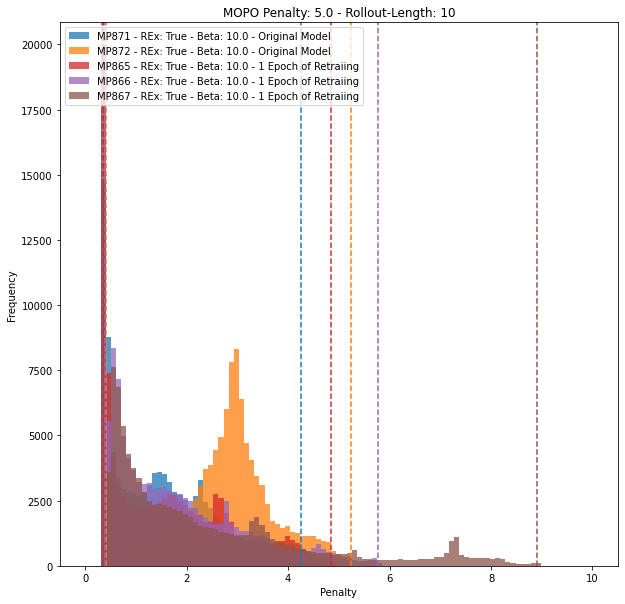

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP871", True, "10.0 - Original Model"),
    ("MP872", True, "10.0 - Original Model"),
    # ("MP873", True, "10.0 - Original Model"),
    ("MP865", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP866", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP867", True, "10.0 - 1 Epoch of Retraiing"),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, _, _, _, pens = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    c_ind = i+1 if i > 1 else i
    ax.hist(pens, bins=np.linspace(0,10,100), color=cols[c_ind], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(exp_details.min_penalty, color=cols[c_ind], ls='--')
    ax.axvline(exp_details.max_penalty, color=cols[c_ind], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Penalty')
ax.set_ylabel('Frequency')
ax.legend(loc='upper left')

# RMSE Histograms

MP862: 0.29679936170578003, 6.183981895446777e-07, 3237.9970703125, 14.6502685546875, 0.4245845317840576
MP863: 8.942280769348145, 1.9073486328125e-06, 606760.8125, 2001.5859375, 0.4178409576416009
MP864: 0.09249714016914368, 4.76837158203125e-07, 67.76795196533203, 0.3796609342098236, 0.28683967590332027
MP865: 0.08771133422851562, 0.0, 55.96464157104492, 0.3176948130130768, 0.2312803268432615
MP866: 0.08391539752483368, 1.9073486328125e-06, 11.868857383728027, 0.14064502716064453, 0.22823607176542268
MP867: 0.08439387381076813, 4.172325134277344e-07, 28.51161003112793, 0.18383896350860596, 0.24315476417541498


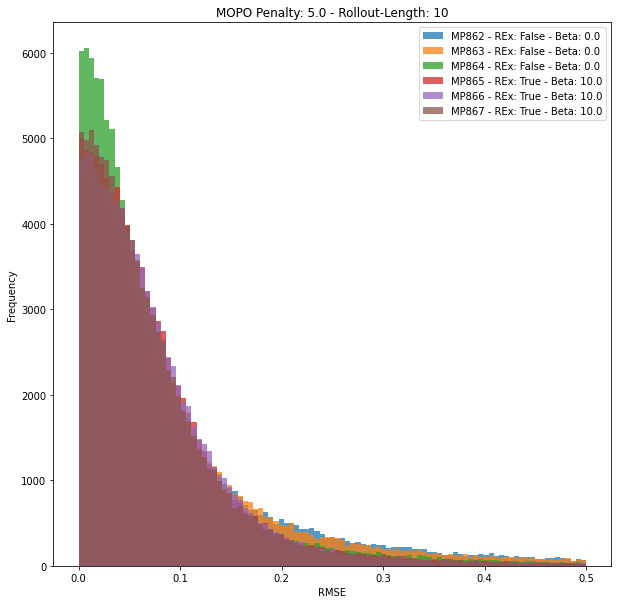

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    rmse_vals = np.sqrt(training_results[exp].mse_results)
    ax.hist(rmse_vals, bins=np.linspace(0,0.5,100), color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    # ax.axvline(np.nanmean(rmse_vals), color=cols[i], ls='--')
    print(f'{exp}: {rmse_vals.mean()}, {rmse_vals.min()}, {rmse_vals.max()}, {rmse_vals.std()}, {np.quantile(rmse_vals, 0.95)}')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('RMSE')
ax.set_ylabel('Frequency')
ax.legend(loc='upper right')

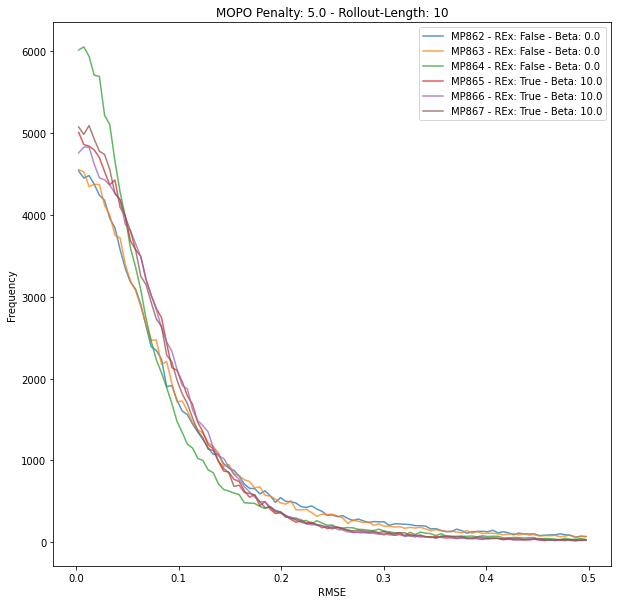

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    bin_min, bin_max, bin_size = 0, 0.5, 100
    bins = np.linspace(bin_min, bin_max, bin_size)
    hist_arr, _ = np.histogram(np.sqrt(training_results[exp].mse_results), bins=bins)
    plt.plot((bins + bin_max/(2*(bin_size-1)))[:-1], hist_arr, color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    # ax.axvline(np.nanmean(np.sqrt(training_results[exp].mse_results)), color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('RMSE')
ax.set_ylabel('Frequency')
ax.legend(loc='upper right')

(-0.01, 0.35)

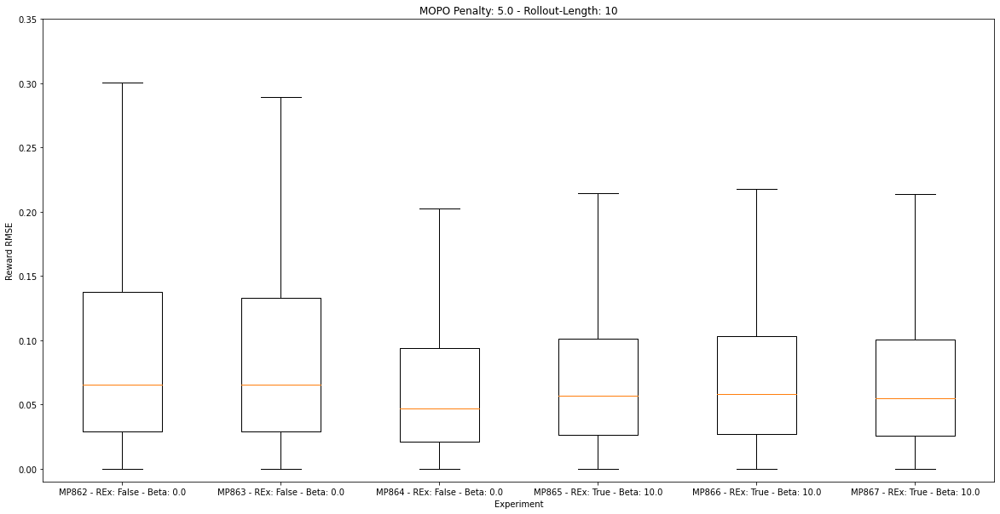

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20,10))

labels = []
rmse_arrs = []
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    labels.append(f'{exp} - REx: {rex} - Beta: {beta}')
    rmse_arrs.append(np.sqrt(training_results[exp].mse_results).flatten())

ax.boxplot(rmse_arrs, showfliers=False, labels=labels)

ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Experiment')
ax.set_ylabel('Reward RMSE')
ax.set_ylim(-0.01,0.35)

MP871: 0.09715773165225983, 70.69192504882812
MP872: 0.17880523204803467, 19.902170181274414
MP873: 0.1828448623418808, 38.47853088378906
MP865: 0.08771133422851562, 55.96464157104492
MP866: 0.08391539752483368, 11.868857383728027
MP867: 0.08439387381076813, 28.51161003112793


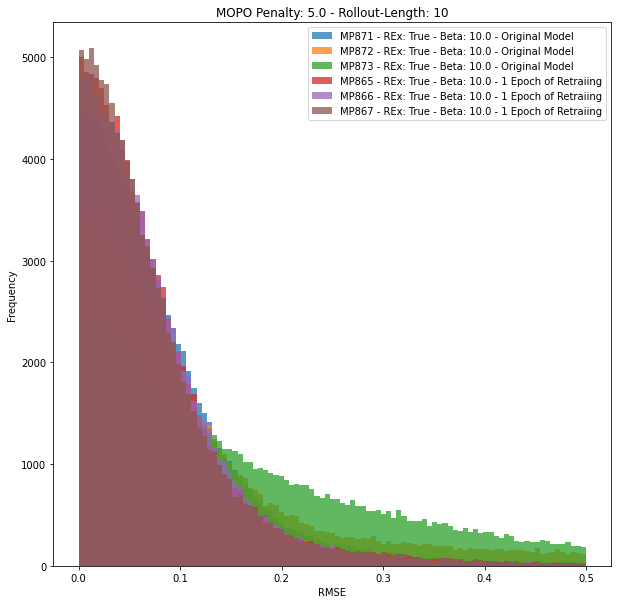

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP871", True, "10.0 - Original Model"),
    ("MP872", True, "10.0 - Original Model"),
    ("MP873", True, "10.0 - Original Model"),
    ("MP865", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP866", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP867", True, "10.0 - 1 Epoch of Retraiing"),
]):
    ax.hist(np.sqrt(training_results[exp].mse_results), bins=np.linspace(0,0.5,100), color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    # ax.axvline(np.nanmean(np.sqrt(training_results[exp].mse_results)), color=cols[i], ls='--')
    print(f'{exp}: {np.sqrt(training_results[exp].mse_results).mean()}, {np.sqrt(training_results[exp].mse_results).max()}')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('RMSE')
ax.set_ylabel('Frequency')
ax.legend(loc='upper right')

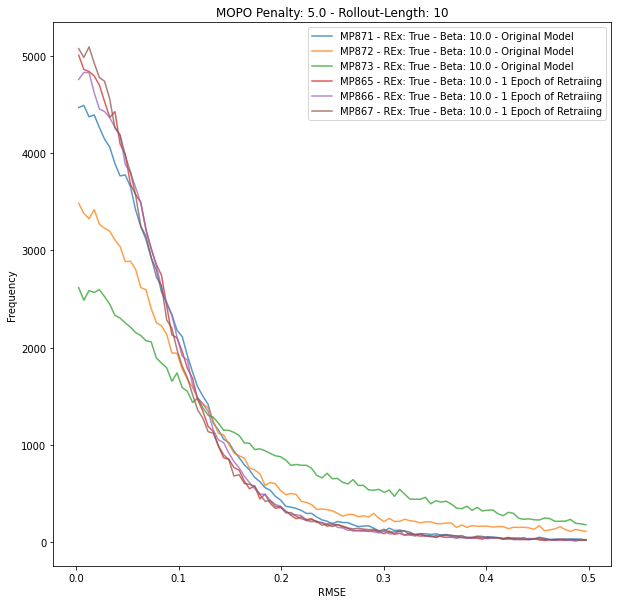

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP871", True, "10.0 - Original Model"),
    ("MP872", True, "10.0 - Original Model"),
    ("MP873", True, "10.0 - Original Model"),
    ("MP865", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP866", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP867", True, "10.0 - 1 Epoch of Retraiing"),
]):
    bin_min, bin_max, bin_size = 0, 0.5, 100
    bins = np.linspace(bin_min, bin_max, bin_size)
    hist_arr, _ = np.histogram(np.sqrt(training_results[exp].mse_results), bins=bins)
    plt.plot((bins + bin_max/(2*(bin_size-1)))[:-1], hist_arr, color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    # ax.axvline(np.nanmean(np.sqrt(training_results[exp].mse_results)), color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('RMSE')
ax.set_ylabel('Frequency')
ax.legend(loc='upper right')

(array([1, 2, 3, 4, 5, 6]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

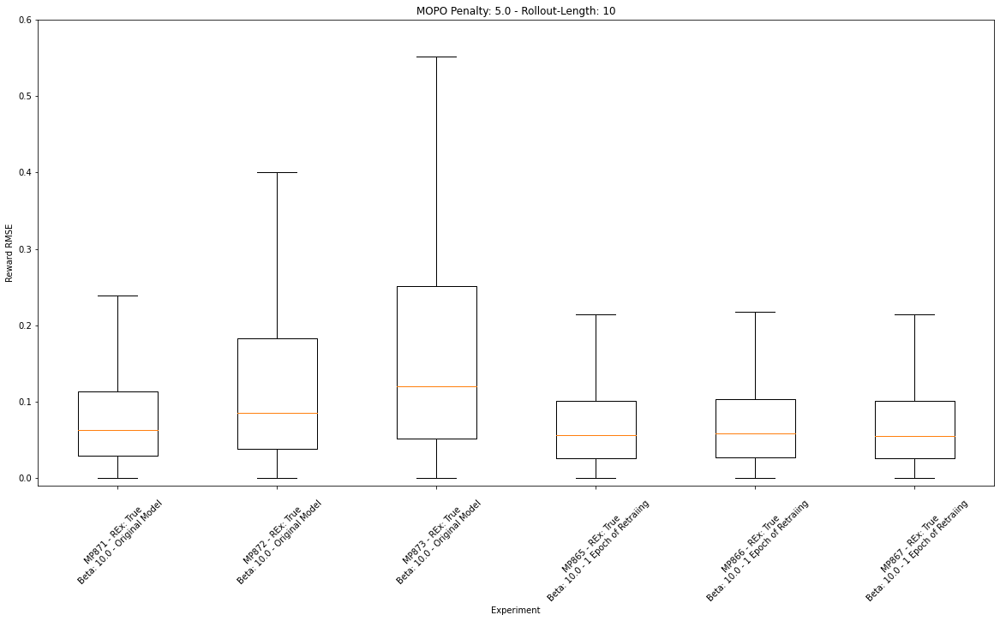

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20,10))

labels = []
rmse_arrs = []
for i, (exp, rex, beta) in enumerate([
    ("MP871", True, "10.0 - Original Model"),
    ("MP872", True, "10.0 - Original Model"),
    ("MP873", True, "10.0 - Original Model"),
    ("MP865", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP866", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP867", True, "10.0 - 1 Epoch of Retraiing"),
]):
    labels.append(f'{exp} - REx: {rex}\nBeta: {beta}')
    rmse_arrs.append(np.sqrt(training_results[exp].mse_results).flatten())

ax.boxplot(rmse_arrs, showfliers=False, labels=labels)

ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Experiment')
ax.set_ylabel('Reward RMSE')
ax.set_ylim(-0.01,0.6)
plt.xticks(rotation=45)

# Penalty/Reward RMSE Calibration

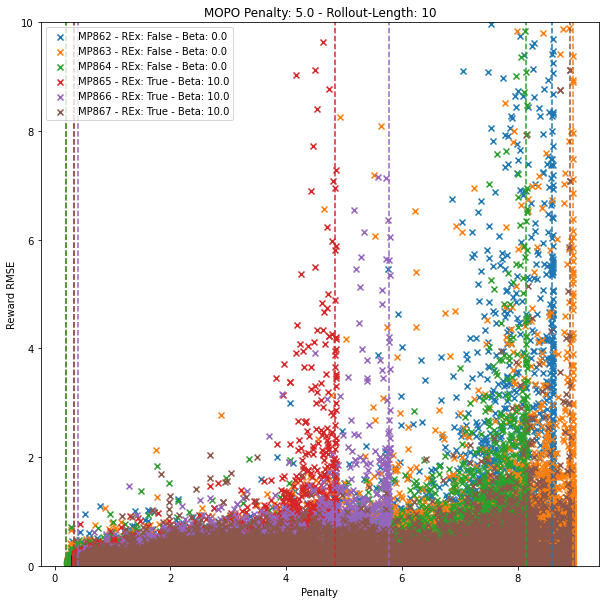

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, _, _, _, pens = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.scatter(pens, np.sqrt(training_results[exp].mse_results), marker='x', color=cols[i], label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(exp_details.min_penalty, color=cols[i], ls='--')
    ax.axvline(exp_details.max_penalty, color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Penalty')
ax.set_ylabel('Reward RMSE')
ax.set_ylim(0, 10)
ax.legend(loc='upper left')

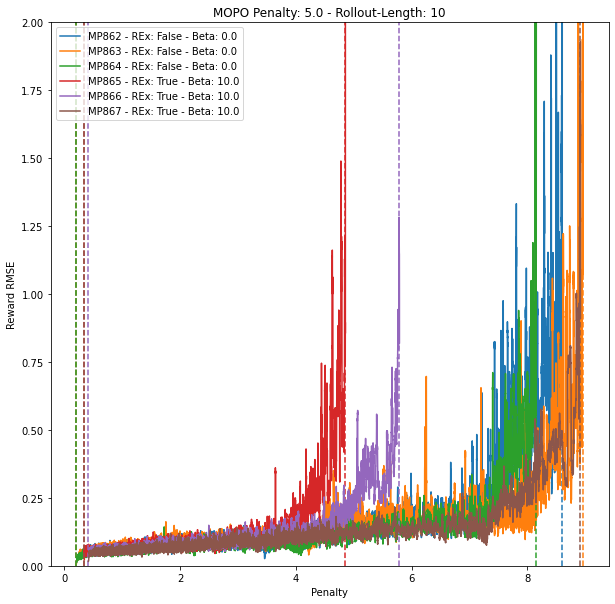

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, _, _, _, pens = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    pen_vals, rmse_err_vals = pens.flatten(), np.sqrt(training_results[exp].mse_results).flatten()
    arg_sort_ind = np.argsort(pen_vals)
    pen_vals, rmse_err_vals = pen_vals[arg_sort_ind], rmse_err_vals[arg_sort_ind]
    
    kernel_size = 50
    kernel = np.ones(kernel_size) / kernel_size
    rmse_err_convolved = np.convolve(rmse_err_vals, kernel, mode='same')

    ax.plot(pen_vals, rmse_err_convolved, color=cols[i], label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(exp_details.min_penalty, color=cols[i], ls='--')
    ax.axvline(exp_details.max_penalty, color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Penalty')
ax.set_ylabel('Reward RMSE')
ax.set_ylim(0, 2)
ax.legend(loc='upper left')

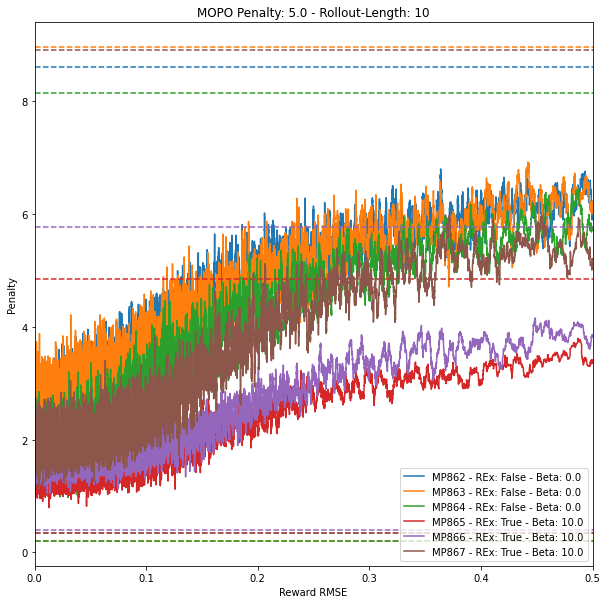

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, _, _, _, pens = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    pen_vals, rmse_err_vals = pens.flatten(), np.sqrt(training_results[exp].mse_results).flatten()
    arg_sort_ind = np.argsort(rmse_err_vals)
    pen_vals, rmse_err_vals = pen_vals[arg_sort_ind], rmse_err_vals[arg_sort_ind]
    
    kernel_size = 50
    kernel = np.ones(kernel_size) / kernel_size
    pen_convolved = np.convolve(pen_vals, kernel, mode='same')

    ax.plot(rmse_err_vals, pen_convolved, color=cols[i], label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axhline(exp_details.min_penalty, color=cols[i], ls='--')
    ax.axhline(exp_details.max_penalty, color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Reward RMSE')
ax.set_ylabel('Penalty')
ax.set_xlim(0, 0.5)
ax.legend(loc='lower right')

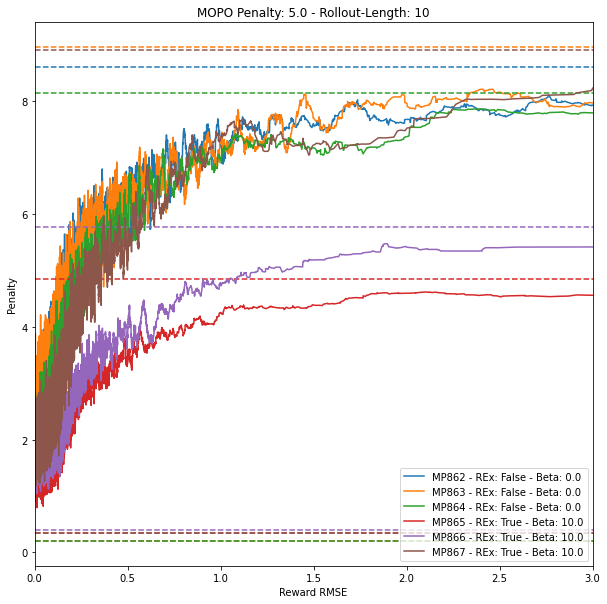

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, _, _, _, pens = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    pen_vals, rmse_err_vals = pens.flatten(), np.sqrt(training_results[exp].mse_results).flatten()
    arg_sort_ind = np.argsort(rmse_err_vals)
    pen_vals, rmse_err_vals = pen_vals[arg_sort_ind], rmse_err_vals[arg_sort_ind]
    
    kernel_size = 50
    kernel = np.ones(kernel_size) / kernel_size
    pen_convolved = np.convolve(pen_vals, kernel, mode='same')

    ax.plot(rmse_err_vals, pen_convolved, color=cols[i], label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axhline(exp_details.min_penalty, color=cols[i], ls='--')
    ax.axhline(exp_details.max_penalty, color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Reward RMSE')
ax.set_ylabel('Penalty')
ax.set_xlim(0, 3)
ax.legend(loc='lower right')

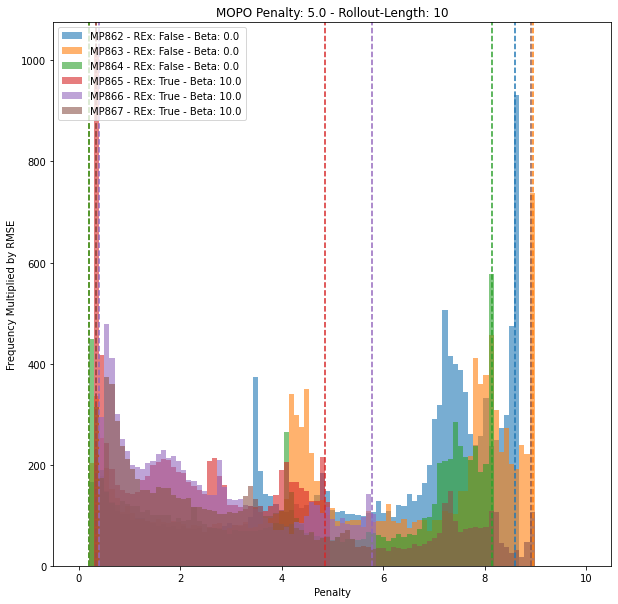

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, _, _, _, pens = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    rmse_vals = np.sqrt(training_results[exp].mse_results).flatten()
    rmse_lim = rmse_vals < 15
    ax.hist(pens.flatten()[rmse_lim], weights=rmse_vals[rmse_lim], bins=np.linspace(0,10,100), color=cols[i], alpha=0.6, label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(exp_details.min_penalty, color=cols[i], ls='--')
    ax.axvline(exp_details.max_penalty, color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Penalty')
ax.set_ylabel('Frequency Multiplied by RMSE')
ax.legend(loc='upper left')

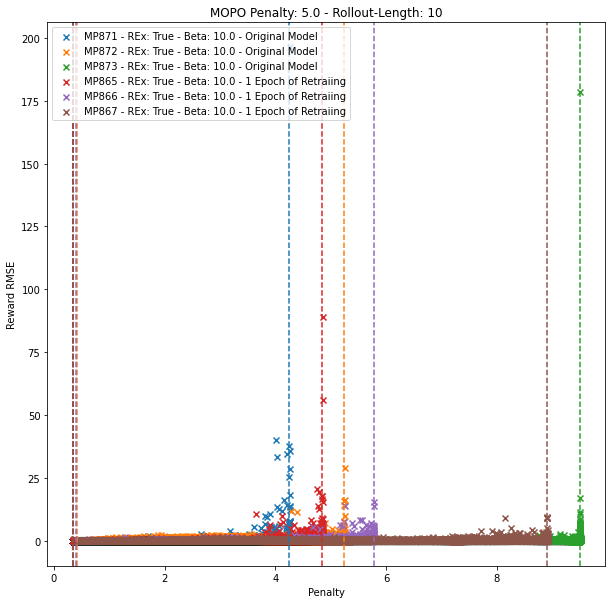

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP871", True, "10.0 - Original Model"),
    ("MP872", True, "10.0 - Original Model"),
    ("MP873", True, "10.0 - Original Model"),
    ("MP865", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP866", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP867", True, "10.0 - 1 Epoch of Retraiing"),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, _, _, _, pens = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.scatter(pens, np.sqrt(training_results[exp].mse_results), marker='x', color=cols[i], label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axvline(exp_details.min_penalty, color=cols[i], ls='--')
    ax.axvline(exp_details.max_penalty, color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Penalty')
ax.set_ylabel('Reward RMSE')
ax.legend(loc='upper left')

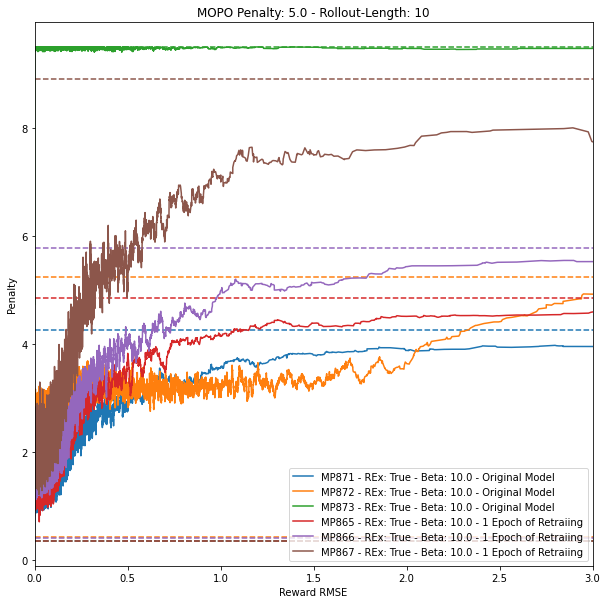

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP871", True, "10.0 - Original Model"),
    ("MP872", True, "10.0 - Original Model"),
    ("MP873", True, "10.0 - Original Model"),
    ("MP865", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP866", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP867", True, "10.0 - 1 Epoch of Retraiing"),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, _, _, _, pens = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    pen_vals, rmse_err_vals = pens.flatten(), np.sqrt(training_results[exp].mse_results).flatten()
    arg_sort_ind = np.argsort(rmse_err_vals)
    pen_vals, rmse_err_vals = pen_vals[arg_sort_ind], rmse_err_vals[arg_sort_ind]
    
    kernel_size = 50
    kernel = np.ones(kernel_size) / kernel_size
    pen_convolved = np.convolve(pen_vals, kernel, mode='same')

    ax.plot(rmse_err_vals, pen_convolved, color=cols[i], label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axhline(exp_details.min_penalty, color=cols[i], ls='--')
    ax.axhline(exp_details.max_penalty, color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Reward RMSE')
ax.set_ylabel('Penalty')
ax.set_xlim(0, 3)
ax.legend(loc='lower right')

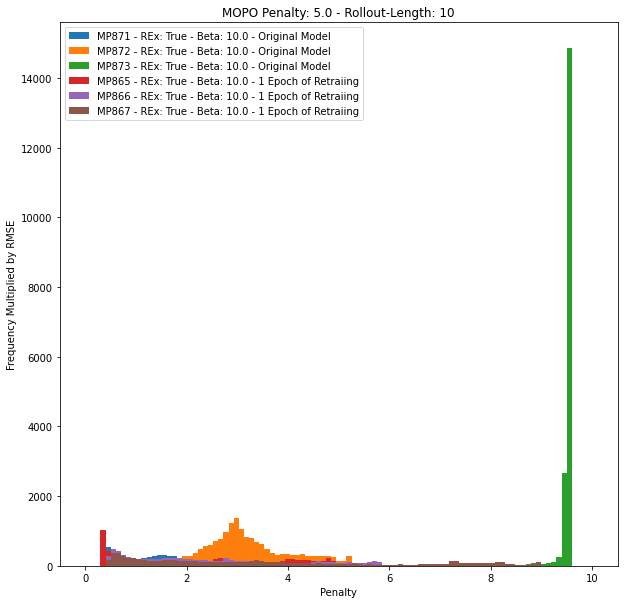

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP871", True, "10.0 - Original Model"),
    ("MP872", True, "10.0 - Original Model"),
    ("MP873", True, "10.0 - Original Model"),
    ("MP865", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP866", True, "10.0 - 1 Epoch of Retraiing"),
    ("MP867", True, "10.0 - 1 Epoch of Retraiing"),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, _, _, _, pens = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    rmse_vals = np.sqrt(training_results[exp].mse_results).flatten()
    rmse_lim = rmse_vals < 15
    ax.hist(pens.flatten()[rmse_lim], weights=rmse_vals[rmse_lim], bins=np.linspace(0,10,100), color=cols[i], label=f'{exp} - REx: {rex} - Beta: {beta}')
    # ax.axvline(exp_details.min_penalty, color=cols[i], ls='--')
    # ax.axvline(exp_details.max_penalty, color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Penalty')
ax.set_ylabel('Frequency Multiplied by RMSE')
ax.legend(loc='upper left')

# Reward/Reward RMSE

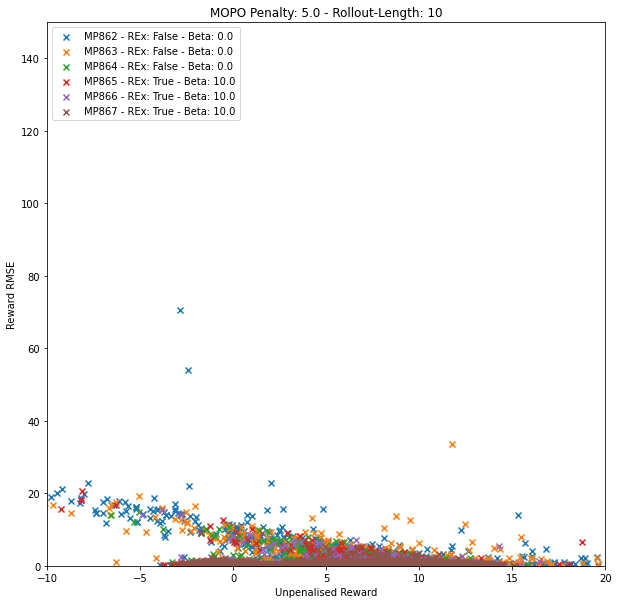

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, rew, _, _, pen = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.scatter(rew+5*pen, np.sqrt(training_results[exp].mse_results), marker='x', color=cols[i], label=f'{exp} - REx: {rex} - Beta: {beta}')
    # ax.axvline(exp_details.max_penalty, color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Unpenalised Reward')
ax.set_ylabel('Reward RMSE')
ax.set_xlim(-10, 20)
ax.set_ylim(0, 150)
ax.legend(loc='upper left')

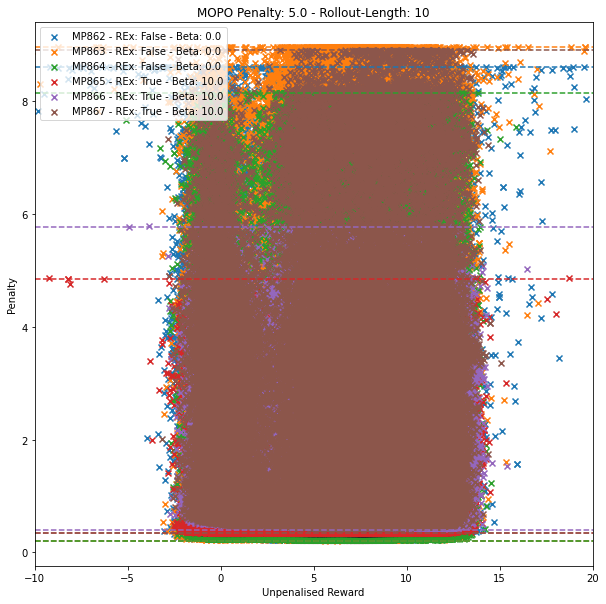

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP862", False, 0.0),
    ("MP863", False, 0.0),
    ("MP864", False, 0.0),
    ("MP865", True, 10.0),
    ("MP866", True, 10.0),
    ("MP867", True, 10.0),
]):
    exp_details = get_experiment_details(exp)
    _, _, _, rew, _, _, pen = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.scatter(rew+5*pen, pen, marker='x', color=cols[i], label=f'{exp} - REx: {rex} - Beta: {beta}')
    ax.axhline(exp_details.min_penalty, color=cols[i], ls='--')
    ax.axhline(exp_details.max_penalty, color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 10')
ax.set_xlabel('Unpenalised Reward')
ax.set_ylabel('Penalty')
ax.set_xlim(-10, 20)
# ax.set_ylim(0, 40)
ax.legend(loc='upper left')

# State-Action Space Visitation

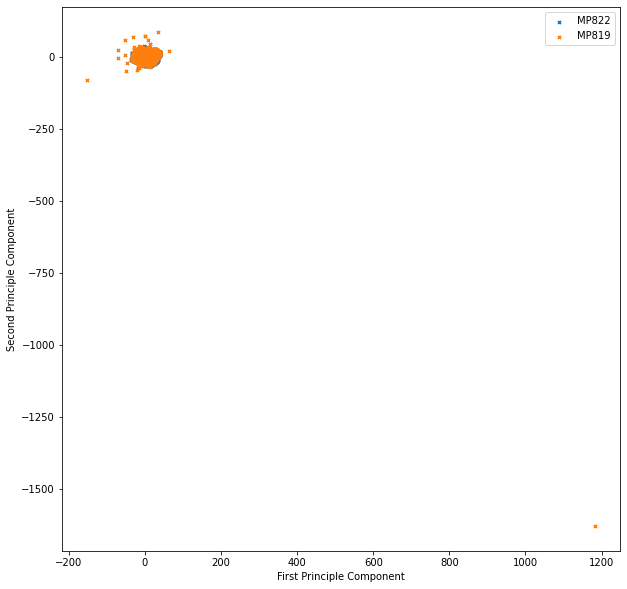

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for exp in ['MP822', 'MP819']:
    ax.scatter(training_results[exp].pca_sa_2d[:,0], training_results[exp].pca_sa_2d[:,1], marker='x', s=10, label=exp)
ax.set_xlabel('First Principle Component')
ax.set_ylabel('Second Principle Component')
ax.legend()

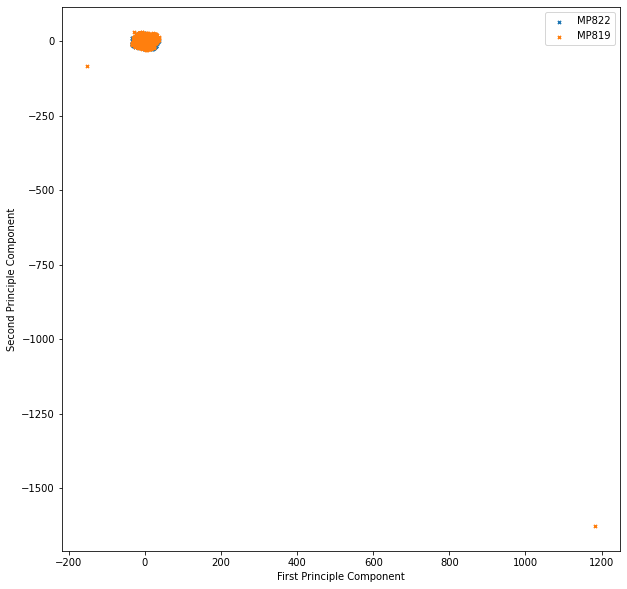

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for exp in ['MP822', 'MP819']:
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    pos_rex_ind = np.where(rew>0.)[0]
    ax.scatter(training_results[exp].pca_sa_2d[pos_rex_ind,0], training_results[exp].pca_sa_2d[pos_rex_ind,1], marker='x', s=10, label=exp)
ax.set_xlabel('First Principle Component')
ax.set_ylabel('Second Principle Component')
ax.legend()

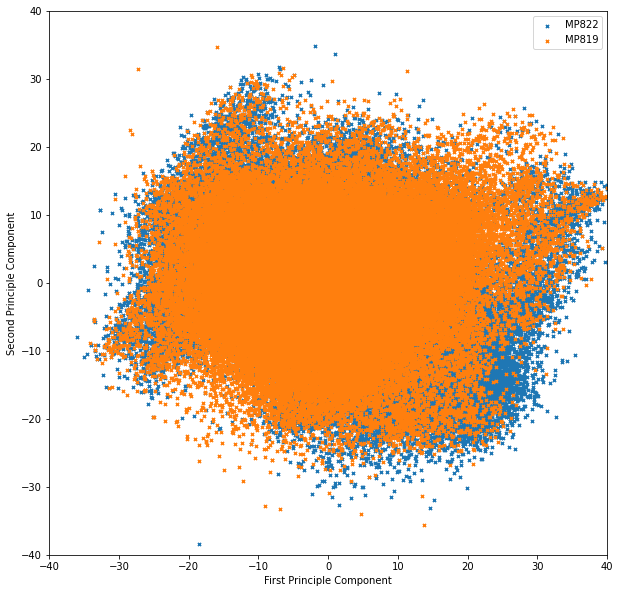

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for exp in ['MP822', 'MP819']:
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.scatter(training_results[exp].pca_sa_2d[:,0], training_results[exp].pca_sa_2d[:,1], marker='x', s=10, label=exp)
    ax.set_xlim(-40,40)
    ax.set_ylim(-40,40)
ax.set_xlabel('First Principle Component')
ax.set_ylabel('Second Principle Component')
ax.legend(loc='upper right')

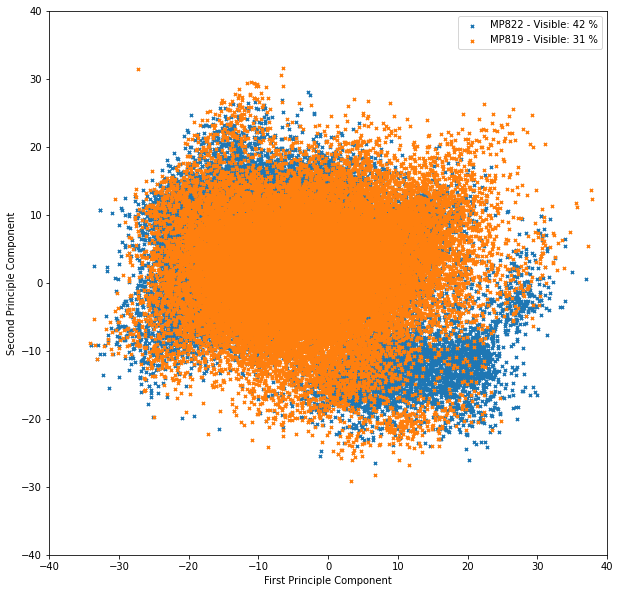

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for exp in ['MP822', 'MP819']:
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    pos_rex_ind = np.where(rew>0.)[0]
    ax.scatter(training_results[exp].pca_sa_2d[pos_rex_ind,0], training_results[exp].pca_sa_2d[pos_rex_ind,1], marker='x', s=10, label=f'{exp} - Visible: {(rew>0.).mean()*100:.0f} %')
    ax.set_xlim(-40,40)
    ax.set_ylim(-40,40)
ax.set_xlabel('First Principle Component')
ax.set_ylabel('Second Principle Component')
ax.legend(loc='upper right')

MOPO Penalty Coefficient 0.0 - Rollout Lenth 5

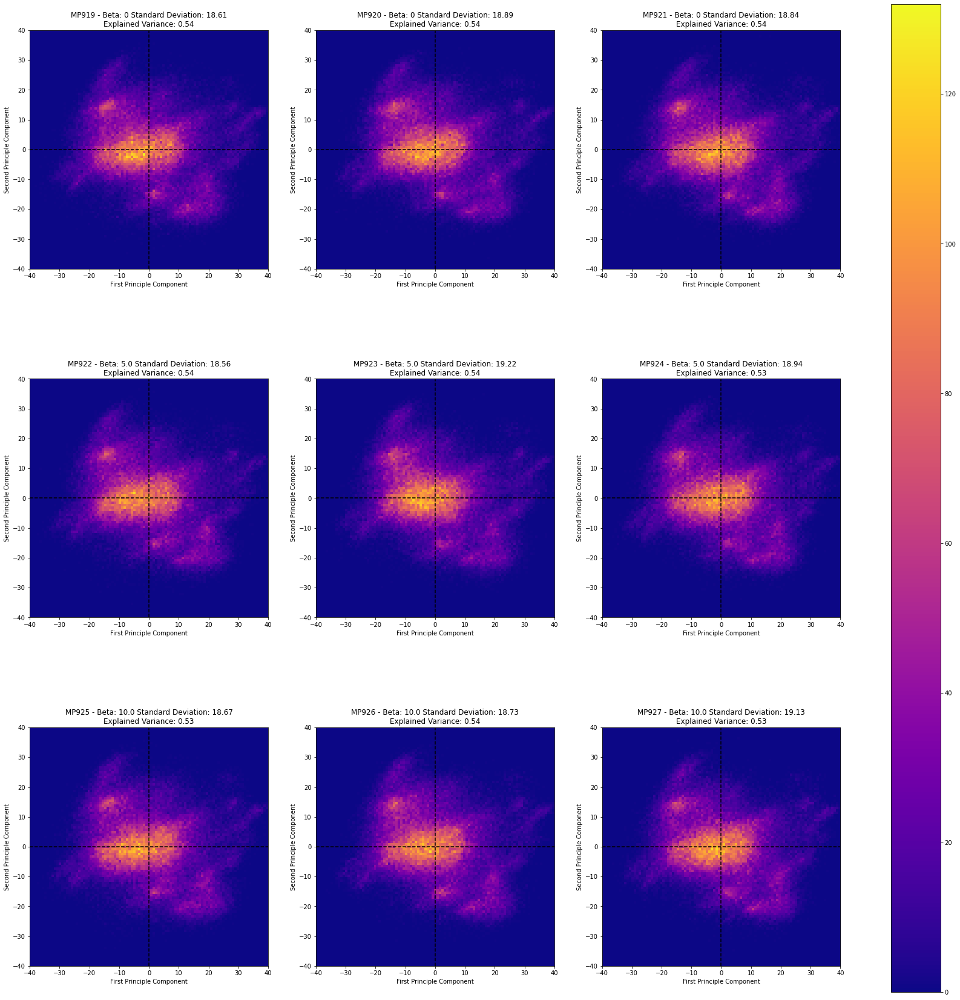

In [ ]:
exp_list_label_set = [
    (("MP919", "MP920", "MP921"), '0'),
    (("MP922", "MP923", "MP924"), '5.0'),
    (("MP925", "MP926", "MP927"), '10.0'),
]
model_pool_visitation_2dhist(training_results, exp_list_label_set)

MOPO Penalty Coefficient 1.0 - Rollout Lenth 5

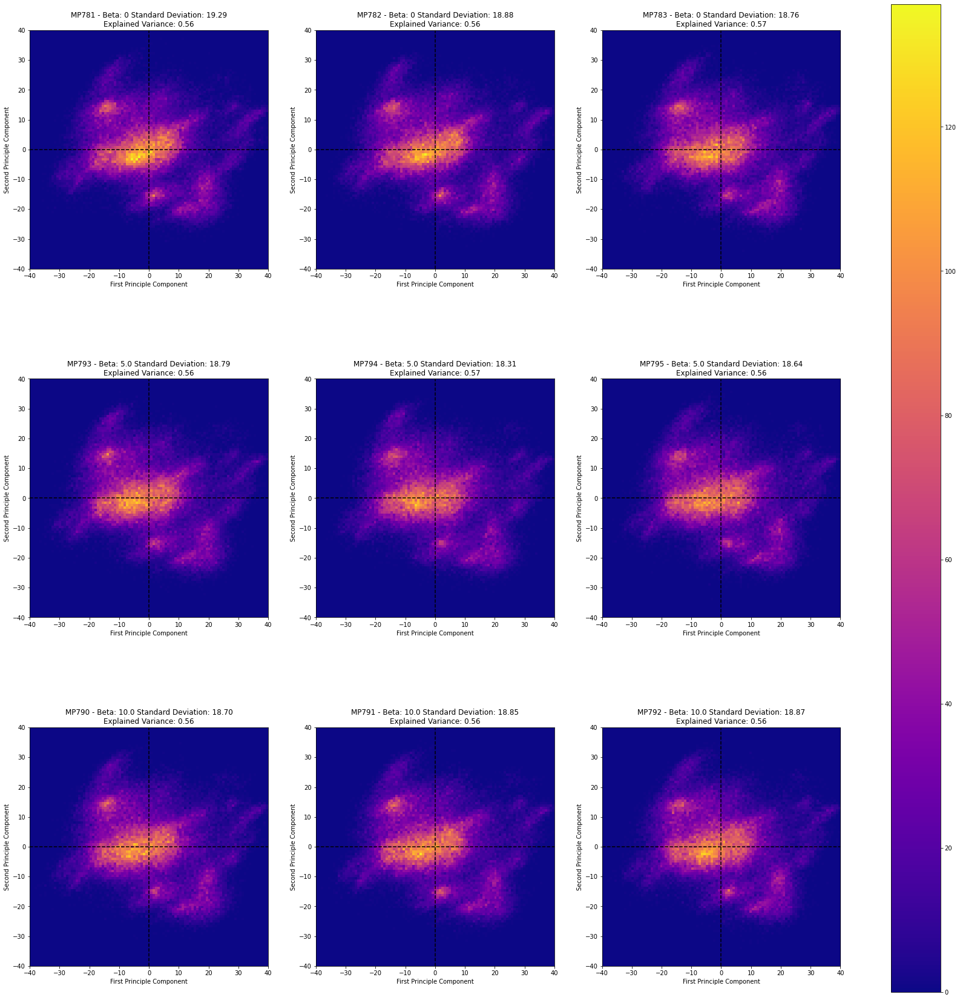

In [ ]:
exp_list_label_set = [
    (("MP781", "MP782", "MP783"), '0'),
    (("MP793", "MP794", "MP795"), '5.0'),
    (("MP790", "MP791", "MP792"), '10.0'),
]
model_pool_visitation_2dhist(training_results, exp_list_label_set)

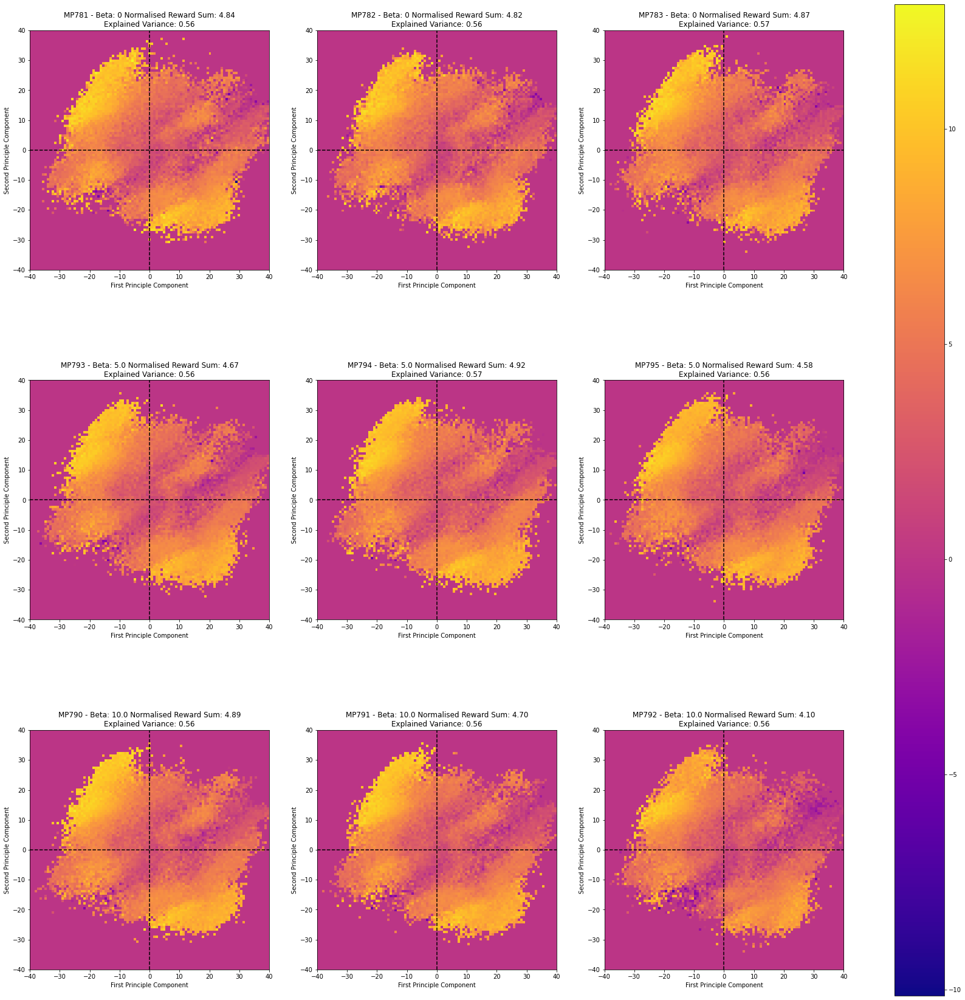

In [ ]:
exp_list_label_set = [
    (("MP781", "MP782", "MP783"), '0'),
    (("MP793", "MP794", "MP795"), '5.0'),
    (("MP790", "MP791", "MP792"), '10.0'),
]
model_pool_pen_rewards_2dhist(training_results, exp_list_label_set)

MOPO Penalty Coefficient 5.0 - Rollout Lenth 5

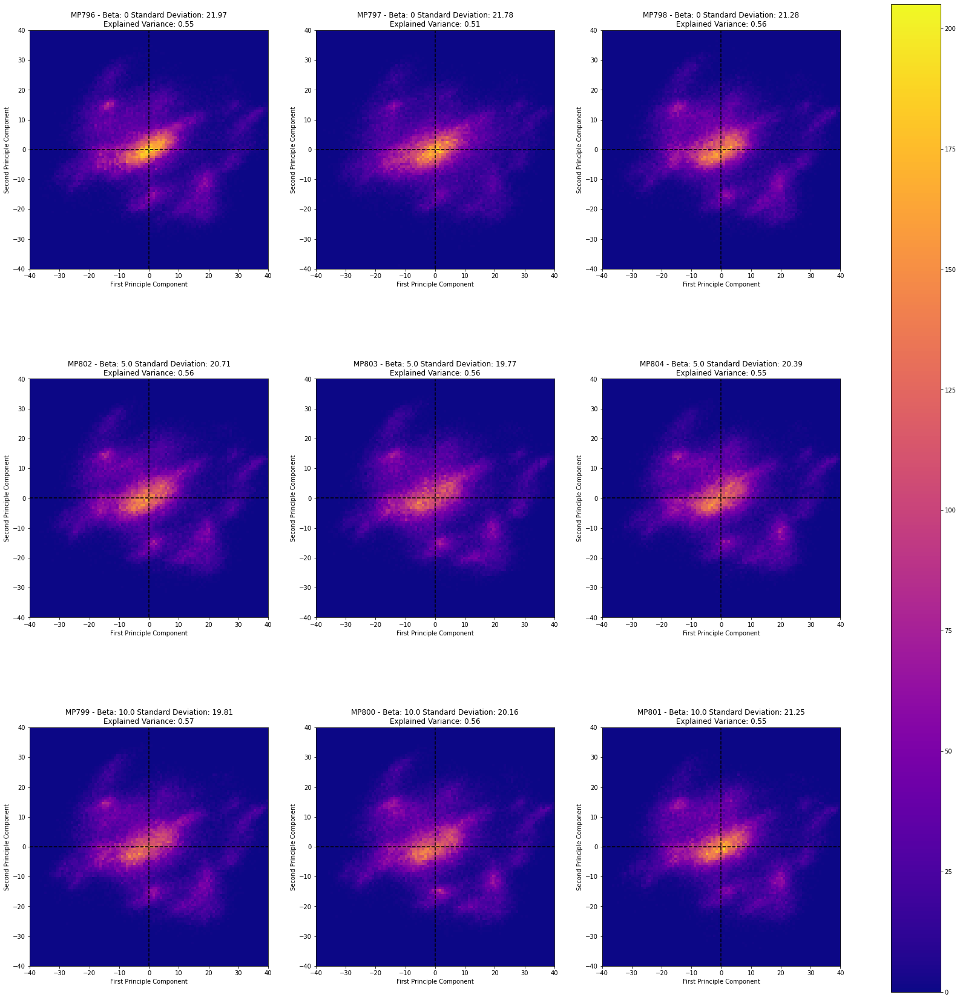

In [ ]:
exp_list_label_set = [
    (("MP796", "MP797", "MP798"), '0'),
    (("MP802", "MP803", "MP804"), '5.0'),
    (("MP799", "MP800", "MP801"), '10.0'),
]
model_pool_visitation_2dhist(training_results, exp_list_label_set)

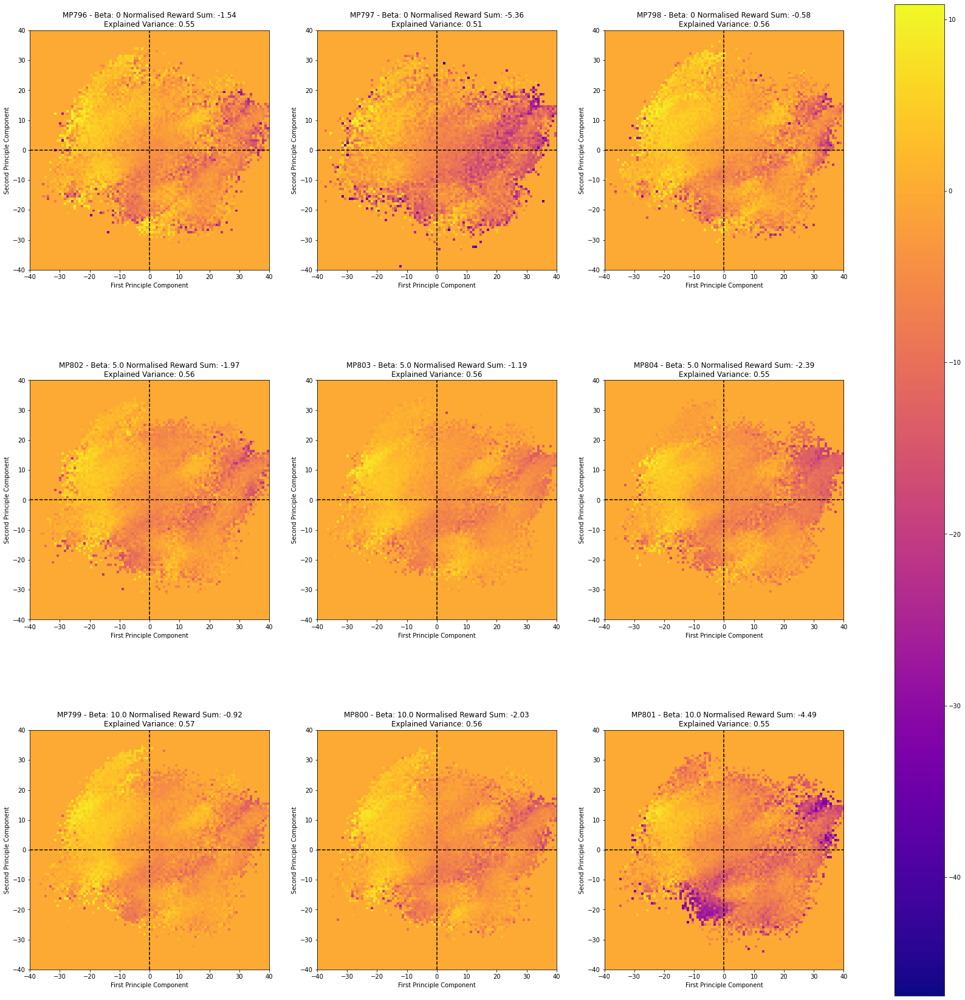

In [ ]:
exp_list_label_set = [
    (("MP796", "MP797", "MP798"), '0'),
    (("MP802", "MP803", "MP804"), '5.0'),
    (("MP799", "MP800", "MP801"), '10.0'),
]
model_pool_pen_rewards_2dhist(training_results, exp_list_label_set)

MOPO Penalty Coefficient 5.0 - Rollout Lenth 10

None


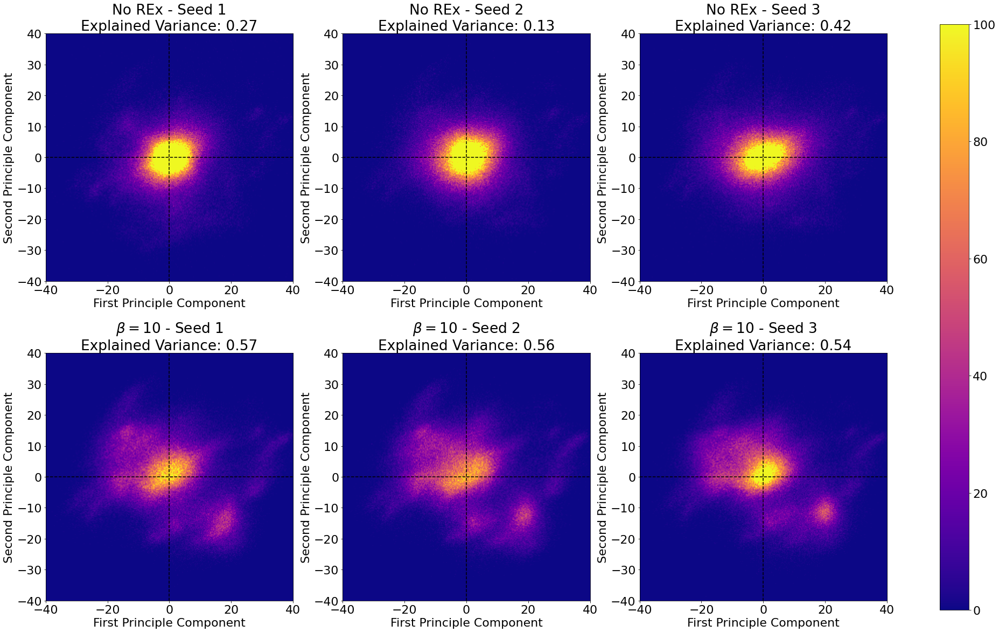

In [31]:
exp_list_label_set = [
    (("MP817", "MP818", "MP819"), 'No REx'),
    # (("MP823", "MP824", "MP825"), '5.0'),
    (("MP820", "MP821", "MP822"), '$\\beta=10$'),
]
fig = model_pool_visitation_2dhist(exp_list_label_set, vmax=100, pca_model=None)
# fig.savefig(os.path.join(os.path.expanduser('~/rds/rds-dsk-lab-eWkDxBhxBrQ/dimorl/code/mopo/figs'), 'workshop', 'pca_hc_mixed_lam5_h10.png'), pad_inches=0.2, bbox_inches='tight')

/rds/user/ajc348/hpc-work/mopo/dogo/visualisation/model_pool_plotting.py:42: RuntimeWarning: invalid value encountered in true_divide
  hist_arr = np.where(counts_arr==0, 0., hist_arr/counts_arr)


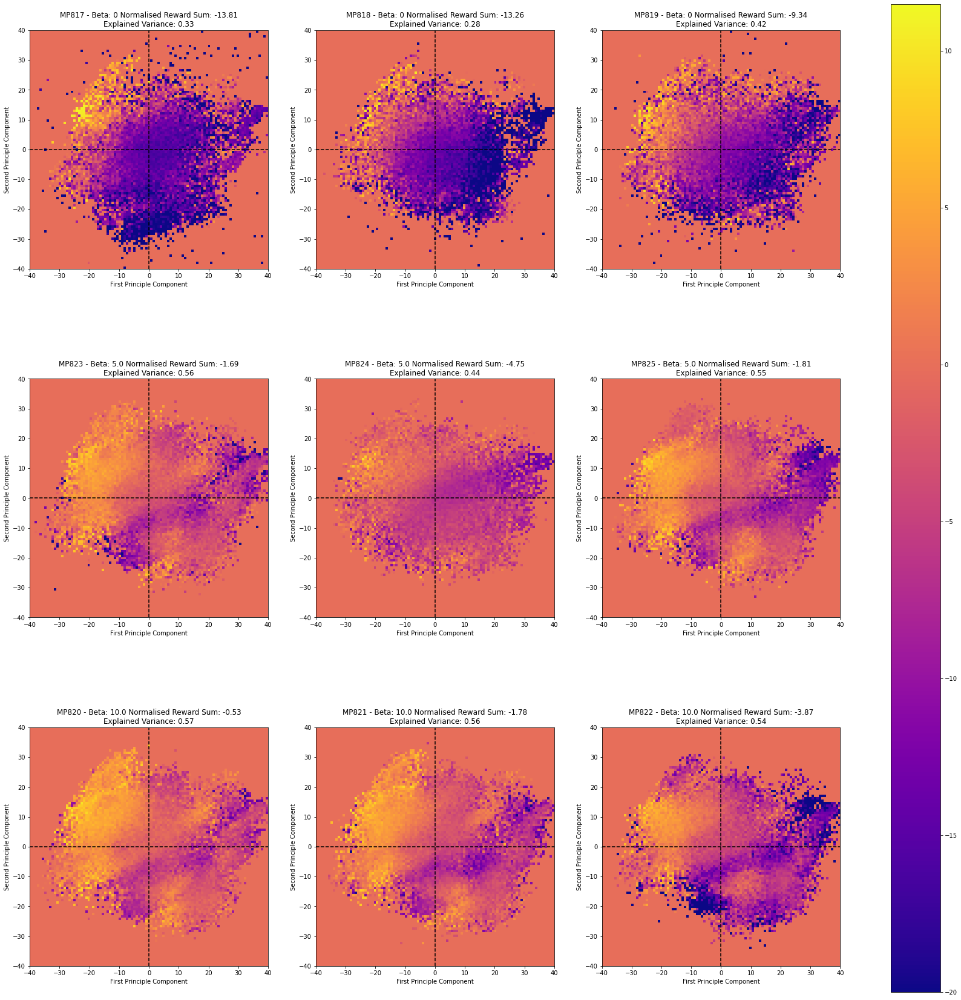

In [ ]:
exp_list_label_set = [
    (("MP817", "MP818", "MP819"), '0'),
    (("MP823", "MP824", "MP825"), '5.0'),
    (("MP820", "MP821", "MP822"), '10.0'),
]
model_pool_pen_rewards_2dhist(training_results, exp_list_label_set, vmin=-20)

MOPO Penalty Coefficient 5.0 - Rollout Lenth 10

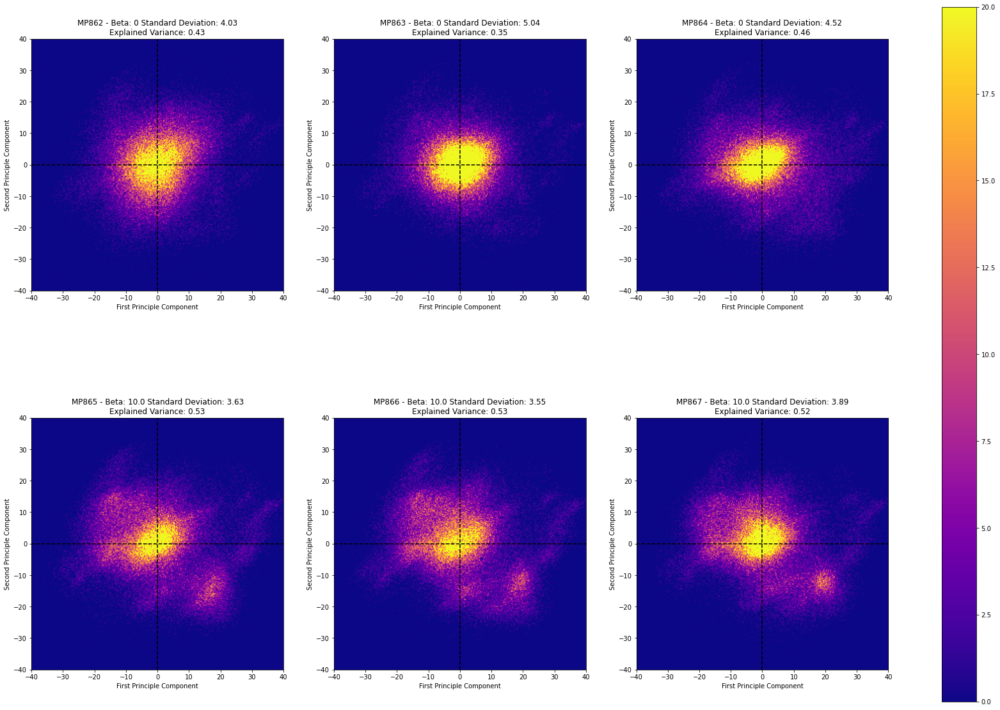

In [ ]:
exp_list_label_set = [
    (("MP862", "MP863", "MP864"), '0'),
    (("MP865", "MP866", "MP867"), '10.0'),
]
model_pool_visitation_2dhist(training_results, exp_list_label_set, vmin=0, vmax=20)

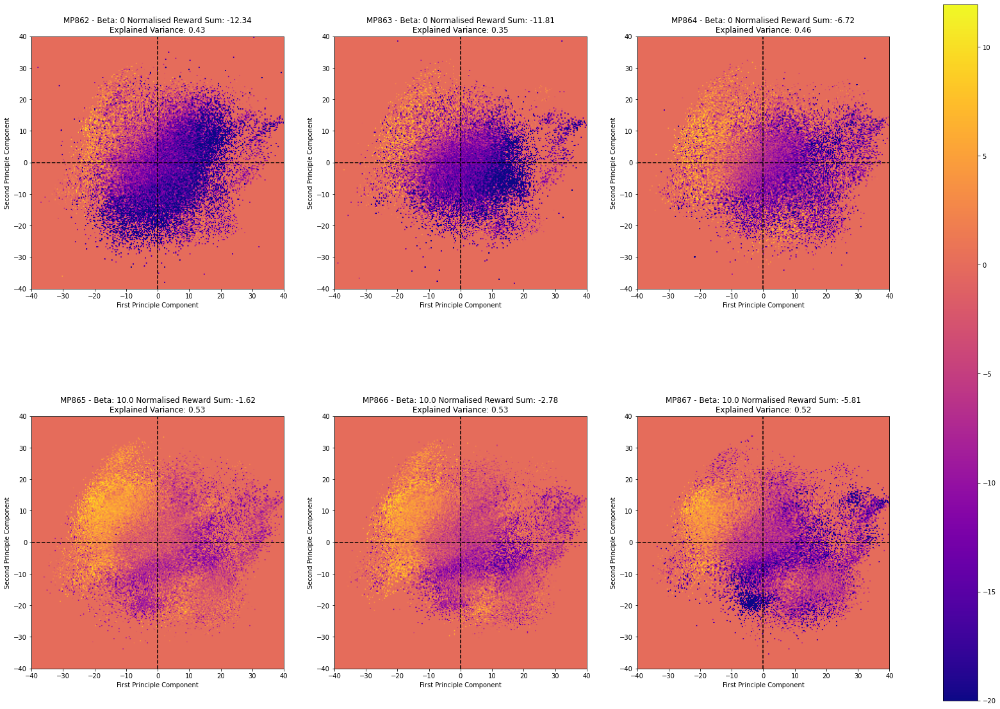

In [ ]:
exp_list_label_set = [
    (("MP862", "MP863", "MP864"), '0'),
    (("MP865", "MP866", "MP867"), '10.0'),
]
model_pool_pen_rewards_2dhist(training_results, exp_list_label_set, vmin=-20)

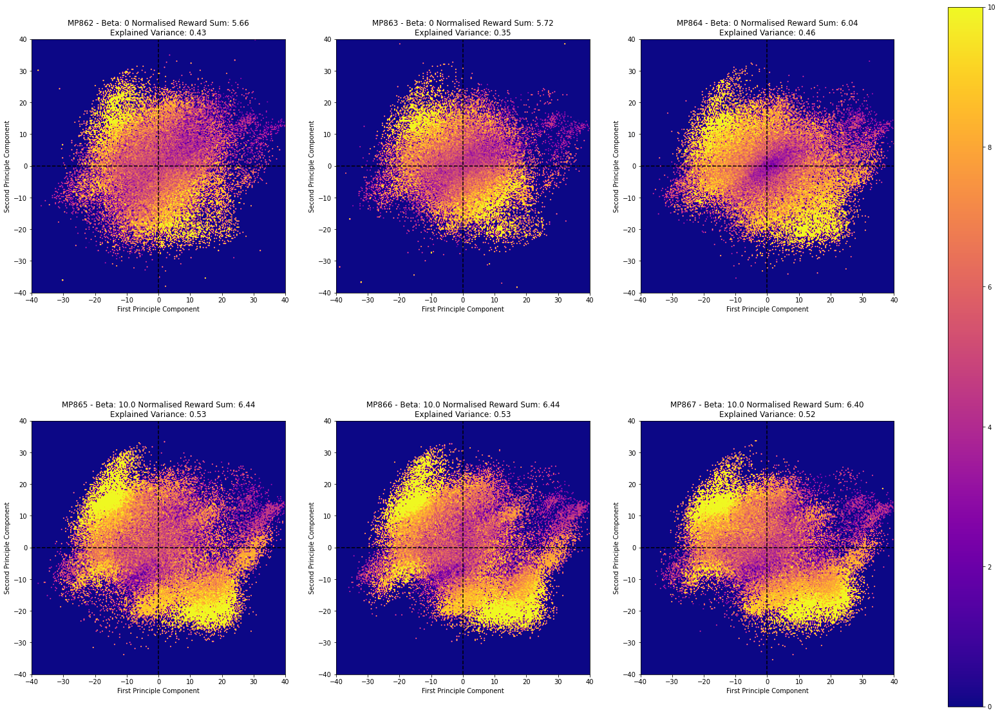

In [ ]:
exp_list_label_set = [
    (("MP862", "MP863", "MP864"), '0'),
    (("MP865", "MP866", "MP867"), '10.0'),
]
model_pool_unpen_rewards_2dhist(training_results, exp_list_label_set, pen_coeff=5.0, vmin=0, vmax=10)

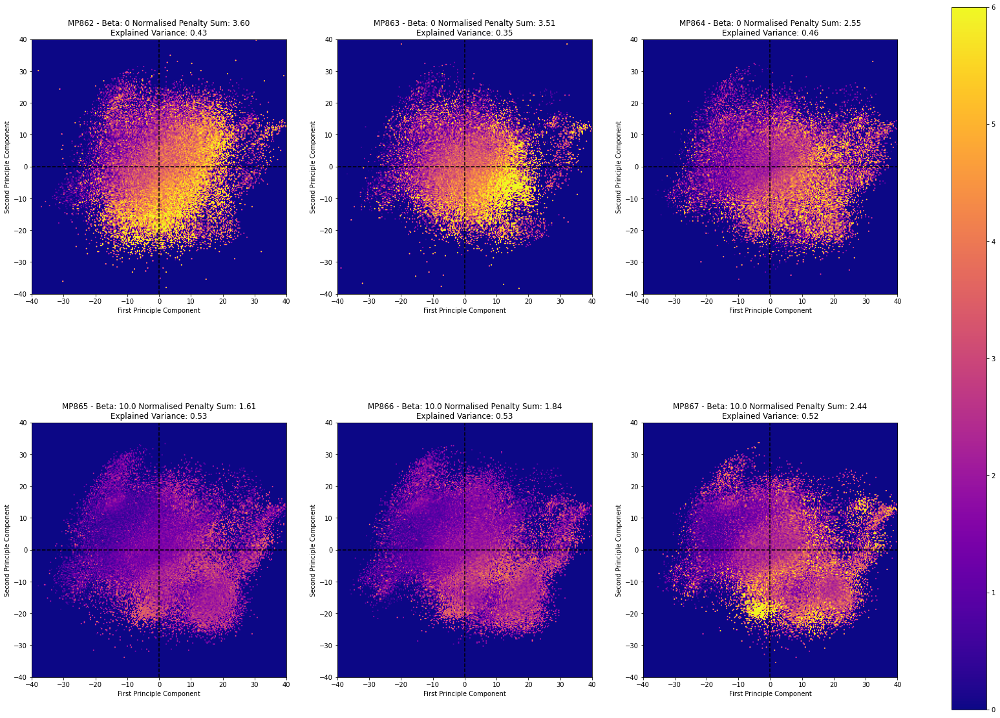

In [ ]:
exp_list_label_set = [
    (("MP862", "MP863", "MP864"), '0'),
    (("MP865", "MP866", "MP867"), '10.0'),
]
model_pool_penalties_2dhist(training_results, exp_list_label_set, vmax=6)

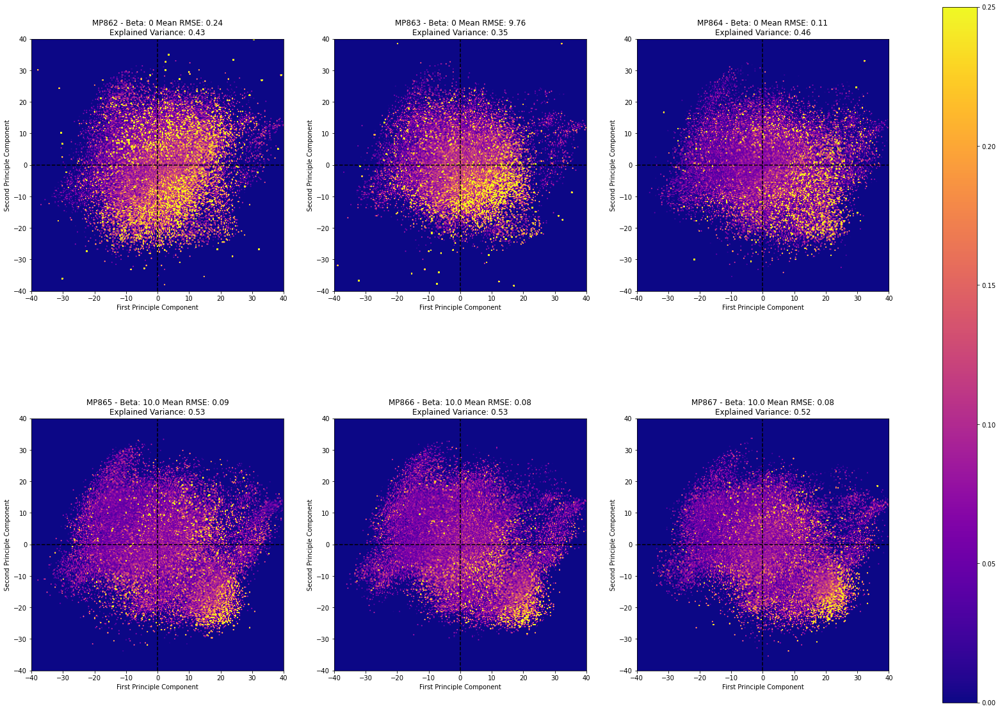

In [ ]:
exp_list_label_set = [
    (("MP862", "MP863", "MP864"), '0'),
    (("MP865", "MP866", "MP867"), '10.0'),
]
model_pool_rmse_2dhist(training_results, exp_list_label_set, vmax=0.25)

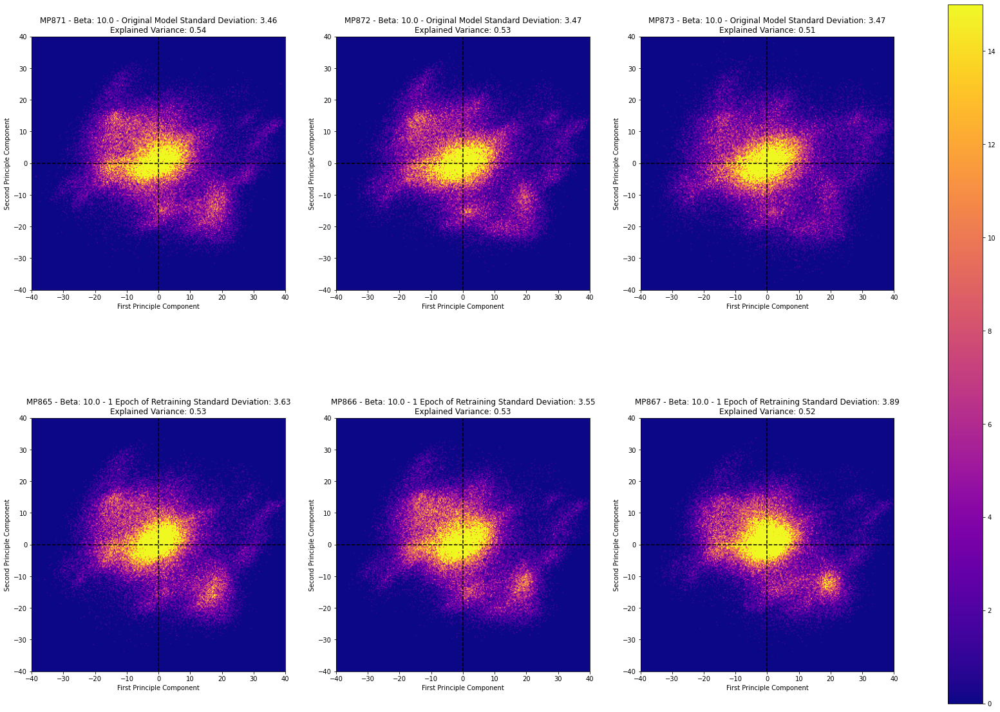

In [ ]:
exp_list_label_set = [
    (("MP871", "MP872", "MP873"), '10.0 - Original Model'),
    (("MP865", "MP866", "MP867"), '10.0 - 1 Epoch of Retraining'),
]
model_pool_visitation_2dhist(training_results, exp_list_label_set, vmax=15)

/rds/user/ajc348/hpc-work/mopo/dogo/visualisation/model_pool_plotting.py:42: RuntimeWarning: invalid value encountered in true_divide
  hist_arr = np.where(counts_arr==0, 0., hist_arr/counts_arr)


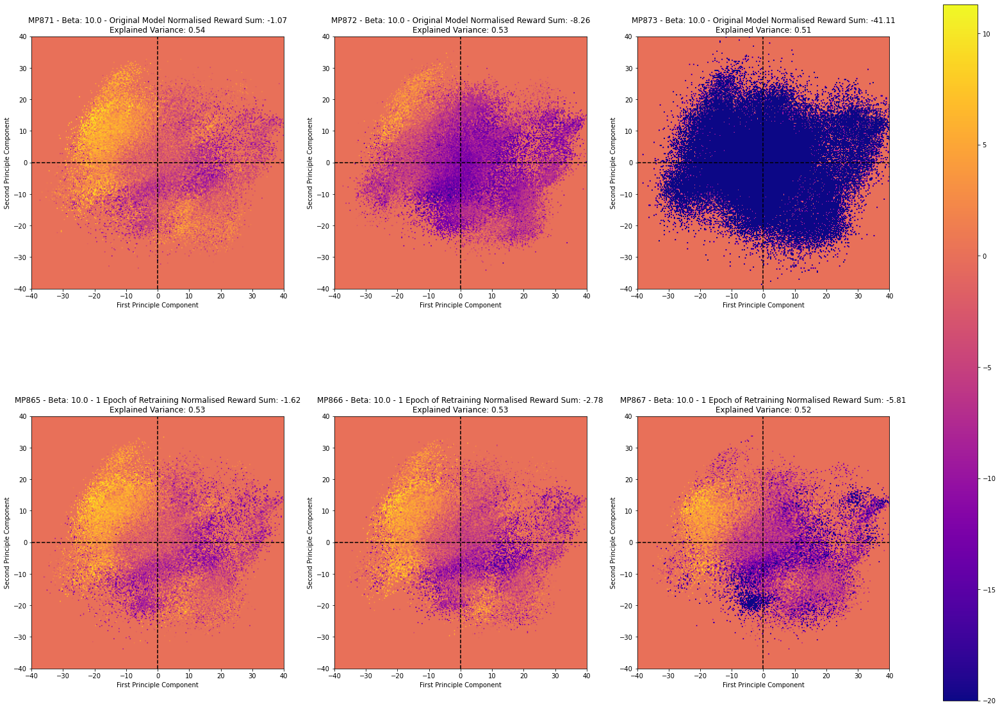

In [ ]:
exp_list_label_set = [
    (("MP871", "MP872", "MP873"), '10.0 - Original Model'),
    (("MP865", "MP866", "MP867"), '10.0 - 1 Epoch of Retraining'),
]
model_pool_pen_rewards_2dhist(training_results, exp_list_label_set, vmin=-20)

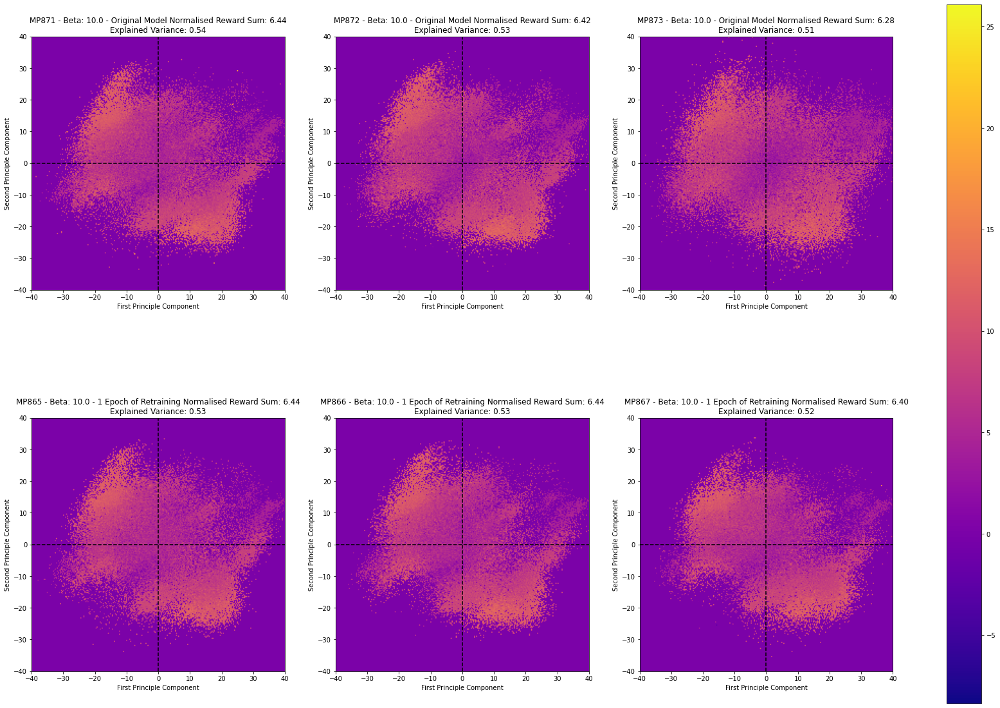

In [ ]:
exp_list_label_set = [
    (("MP871", "MP872", "MP873"), '10.0 - Original Model'),
    (("MP865", "MP866", "MP867"), '10.0 - 1 Epoch of Retraining'),
]
model_pool_unpen_rewards_2dhist(training_results, exp_list_label_set, pen_coeff=5)

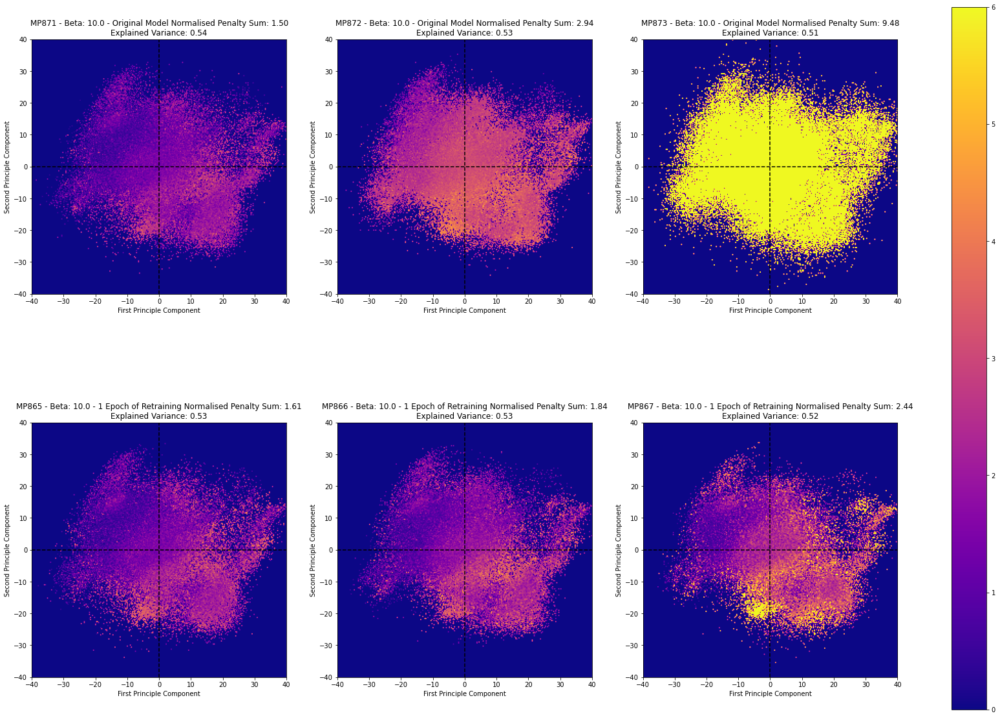

In [ ]:
exp_list_label_set = [
    (("MP871", "MP872", "MP873"), '10.0 - Original Model'),
    (("MP865", "MP866", "MP867"), '10.0 - 1 Epoch of Retraining'),
]
model_pool_penalties_2dhist(training_results, exp_list_label_set, vmax=6)

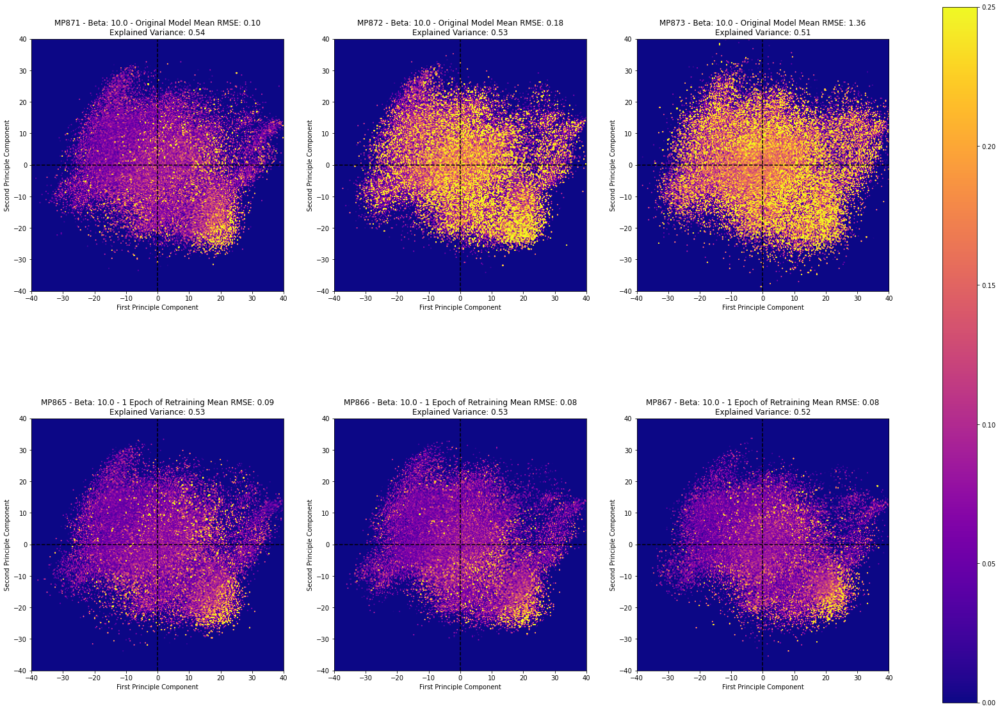

In [ ]:
exp_list_label_set = [
    (("MP871", "MP872", "MP873"), '10.0 - Original Model'),
    (("MP865", "MP866", "MP867"), '10.0 - 1 Epoch of Retraining'),
]
model_pool_rmse_2dhist(training_results, exp_list_label_set, vmax=0.25)

# Reward

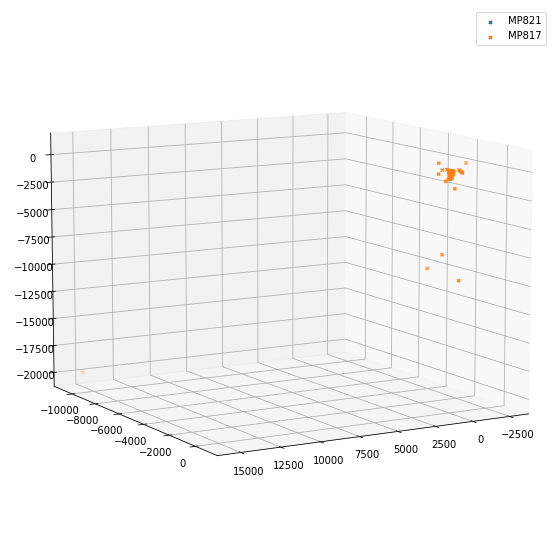

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10), subplot_kw={"projection": "3d"})
for exp in ['MP821', 'MP817']:
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.scatter(training_results[exp].pca_sa_2d[:,0], training_results[exp].pca_sa_2d[:,1], rew, marker='x', s=10, label=exp)
    ax.view_init(10, 60)
ax.legend()

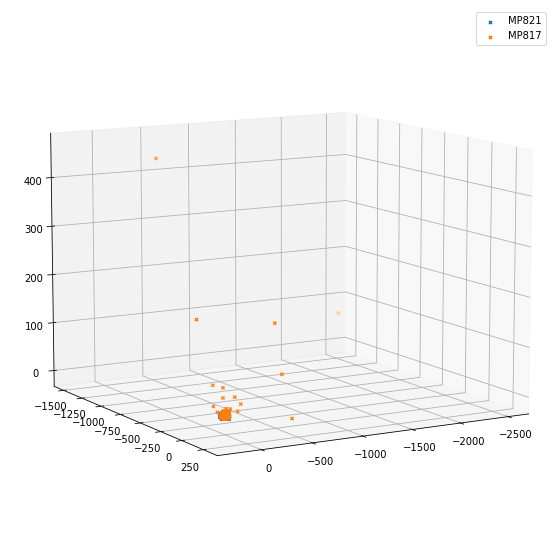

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10), subplot_kw={"projection": "3d"})
for exp in ['MP821', 'MP817']:
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    pos_rex_ind = np.where(rew>0.)[0]
    ax.scatter(training_results[exp].pca_sa_2d[pos_rex_ind,0], training_results[exp].pca_sa_2d[pos_rex_ind,1], rew[pos_rex_ind], marker='x', s=10, label=exp)
    ax.view_init(10, 60)
ax.legend()

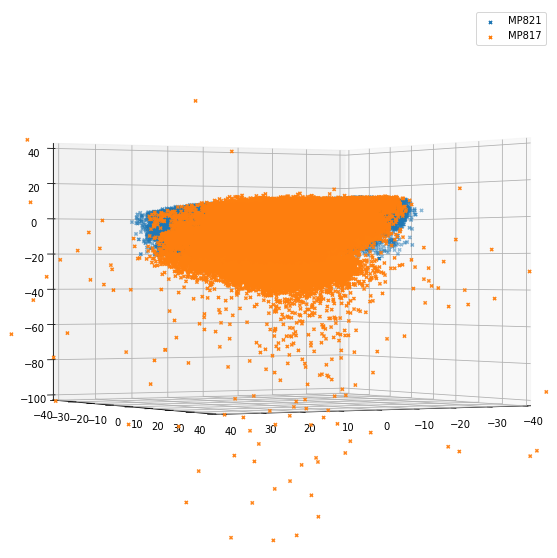

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10), subplot_kw={"projection": "3d"})
for exp in ['MP821', 'MP817']:
    _, _, _, rew, _, _, _ = split_halfcheetah_v2_trans_arr(training_results[exp].pool)
    ax.scatter(training_results[exp].pca_sa_2d[:,0], training_results[exp].pca_sa_2d[:,1], rew, marker='x', s=10, label=exp)
    ax.view_init(0, 60)
    ax.set_xlim(-40,40)
    ax.set_ylim(-40,40)
    ax.set_zlim(-100,40)
ax.legend()

# D4RL MR Dataset

In [ ]:
D4RL_MR_EXP_LIST = [
    # No REx - MOPO Pen 5 - Rollout Length 5
    "MP898",
    "MP899",
    "MP900",
    # REx 10 - MOPO Pen 5 - Rollout Length 5
    "MP901",
    "MP902",
    "MP903",
    # No REx - MOPO Pen 5 - Rollout Length 10
    "MP904",
    "MP905",
    "MP906",
    # REx 10 - MOPO Pen 5 - Rollout Length 10
    "MP907",
    "MP908",
    "MP909",
    # REx 10 - MOPO Pen 5 - Rollout Length 5 - No Additional Training
    "MP910",
    "MP911",
    "MP912",
    # No REx - MOPO Pen 5 - Rollout Length 5 - 3 Epochs Additional Training
    "MP913",
    "MP914",
    "MP915",
    # REx 10 - MOPO Pen 5 - Rollout Length 5 - 3 Epochs Additional Training
    "MP916",
    "MP917",
    "MP918",
]
d4rl_mr_training_results = {}
for exp in D4RL_MR_EXP_LIST:
    d4rl_mr_training_results[exp] = PoolArrs(*get_sac_pools(exp))

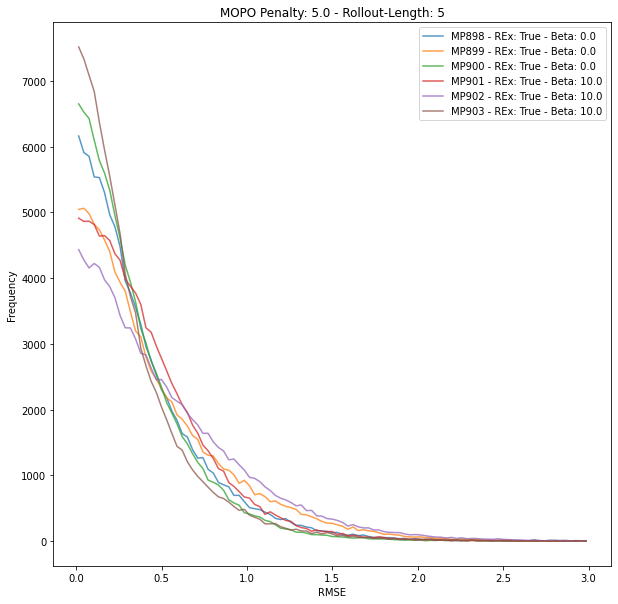

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP898", True, 0.0),
    ("MP899", True, 0.0),
    ("MP900", True, 0.0),
    ("MP901", True, 10.0),
    ("MP902", True, 10.0),
    ("MP903", True, 10.0),
]):
    bin_min, bin_max, bin_size = 0, 3, 100
    bins = np.linspace(bin_min, bin_max, bin_size)
    hist_arr, _ = np.histogram(np.sqrt(d4rl_mr_training_results[exp].mse_results), bins=bins)
    plt.plot((bins + bin_max/(2*(bin_size-1)))[:-1], hist_arr, color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    # ax.axvline(np.nanmean(np.sqrt(training_results[exp].mse_results)), color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 5')
ax.set_xlabel('RMSE')
ax.set_ylabel('Frequency')
ax.legend(loc='upper right')

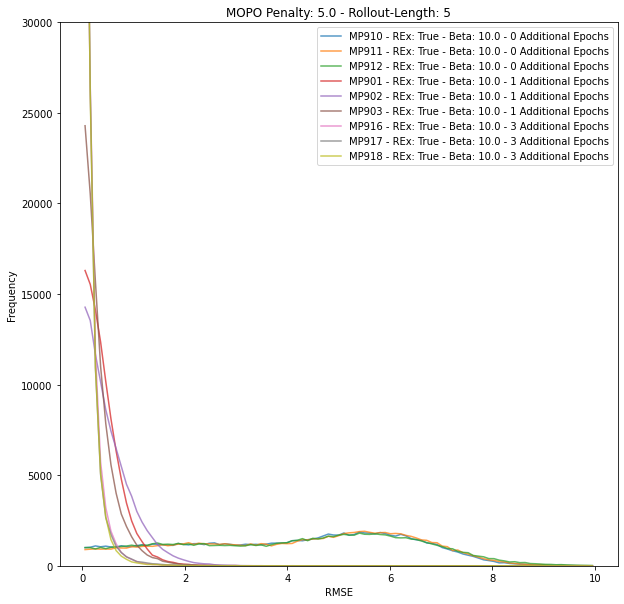

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for i, (exp, rex, beta) in enumerate([
    ("MP910", True, "10.0 - 0 Additional Epochs"),
    ("MP911", True, "10.0 - 0 Additional Epochs"),
    ("MP912", True, "10.0 - 0 Additional Epochs"),
    ("MP901", True, "10.0 - 1 Additional Epochs"),
    ("MP902", True, "10.0 - 1 Additional Epochs"),
    ("MP903", True, "10.0 - 1 Additional Epochs"),
    ("MP916", True, "10.0 - 3 Additional Epochs"),
    ("MP917", True, "10.0 - 3 Additional Epochs"),
    ("MP918", True, "10.0 - 3 Additional Epochs"),
]):
    bin_min, bin_max, bin_size = 0, 10, 100
    bins = np.linspace(bin_min, bin_max, bin_size)
    hist_arr, _ = np.histogram(np.sqrt(d4rl_mr_training_results[exp].mse_results), bins=bins)
    plt.plot((bins + bin_max/(2*(bin_size-1)))[:-1], hist_arr, color=cols[i], alpha=0.75, label=f'{exp} - REx: {rex} - Beta: {beta}')
    # ax.axvline(np.nanmean(np.sqrt(training_results[exp].mse_results)), color=cols[i], ls='--')
ax.set_title('MOPO Penalty: 5.0 - Rollout-Length: 5')
ax.set_xlabel('RMSE')
ax.set_ylabel('Frequency')
ax.set_ylim(0,30000)
ax.legend(loc='upper right')

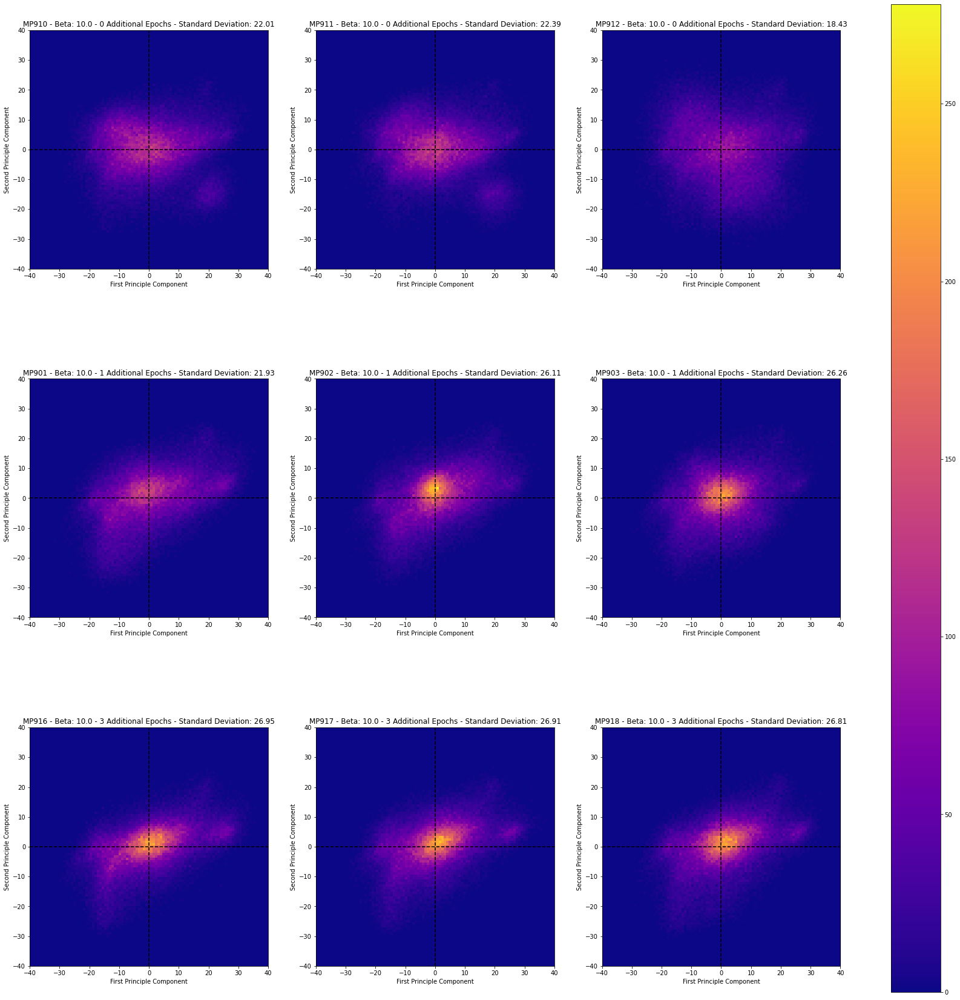

In [ ]:
exp_list_label_set = [
    (("MP910", "MP911", "MP912"), '10.0 - 0 Additional Epochs'),
    (("MP901", "MP902", "MP903"), '10.0 - 1 Additional Epochs'),
    (("MP916", "MP917", "MP918"), '10.0 - 3 Additional Epochs'),
    # (("MP898", "MP899", "MP900"), '0 - Rollout Length 5'),
    # (("MP907", "MP908", "MP909"), '10.0 - Rollout Length 10'),
]
model_pool_visitation_2dhist(d4rl_mr_training_results, exp_list_label_set)

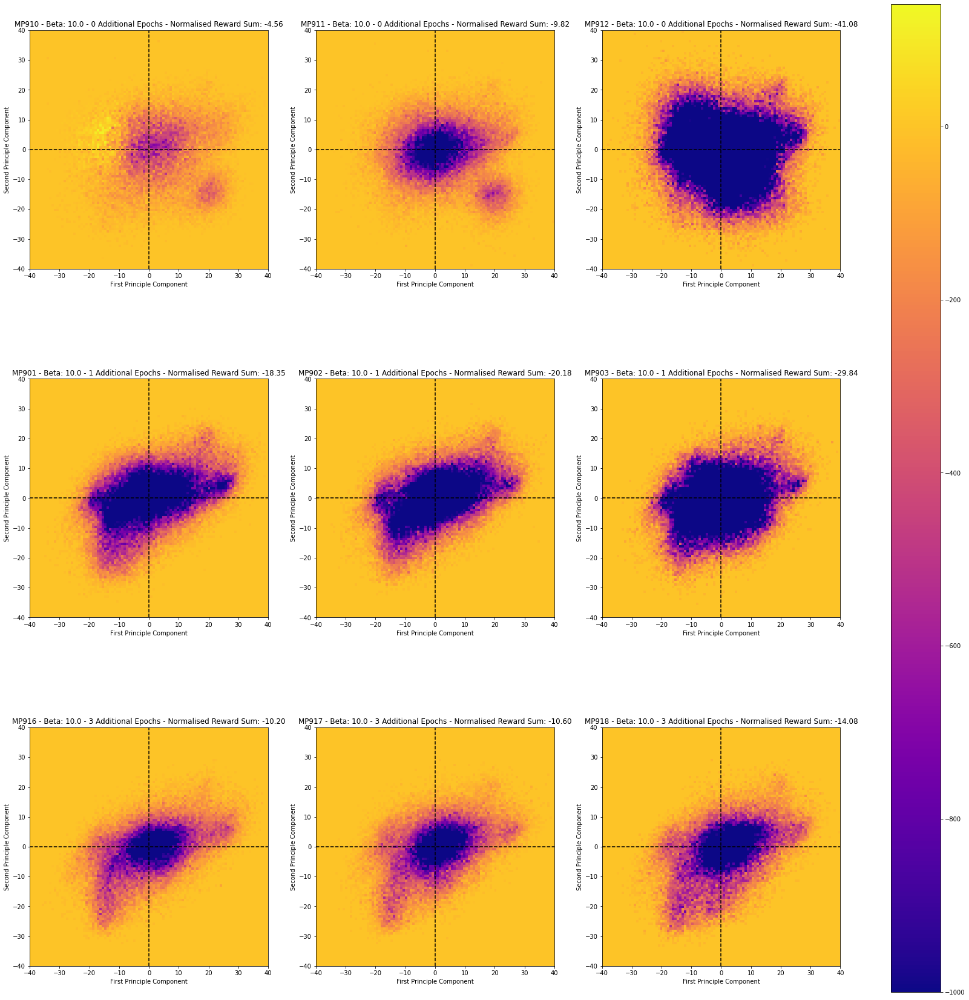

In [ ]:
exp_list_label_set = [
    (("MP910", "MP911", "MP912"), '10.0 - 0 Additional Epochs'),
    (("MP901", "MP902", "MP903"), '10.0 - 1 Additional Epochs'),
    (("MP916", "MP917", "MP918"), '10.0 - 3 Additional Epochs'),
    # (("MP898", "MP899", "MP900"), '0 - Rollout Length 5'),
    # (("MP907", "MP908", "MP909"), '10.0 - Rollout Length 10'),
]
model_pool_pen_rewards_2dhist(d4rl_mr_training_results, exp_list_label_set, vmin=-1000)

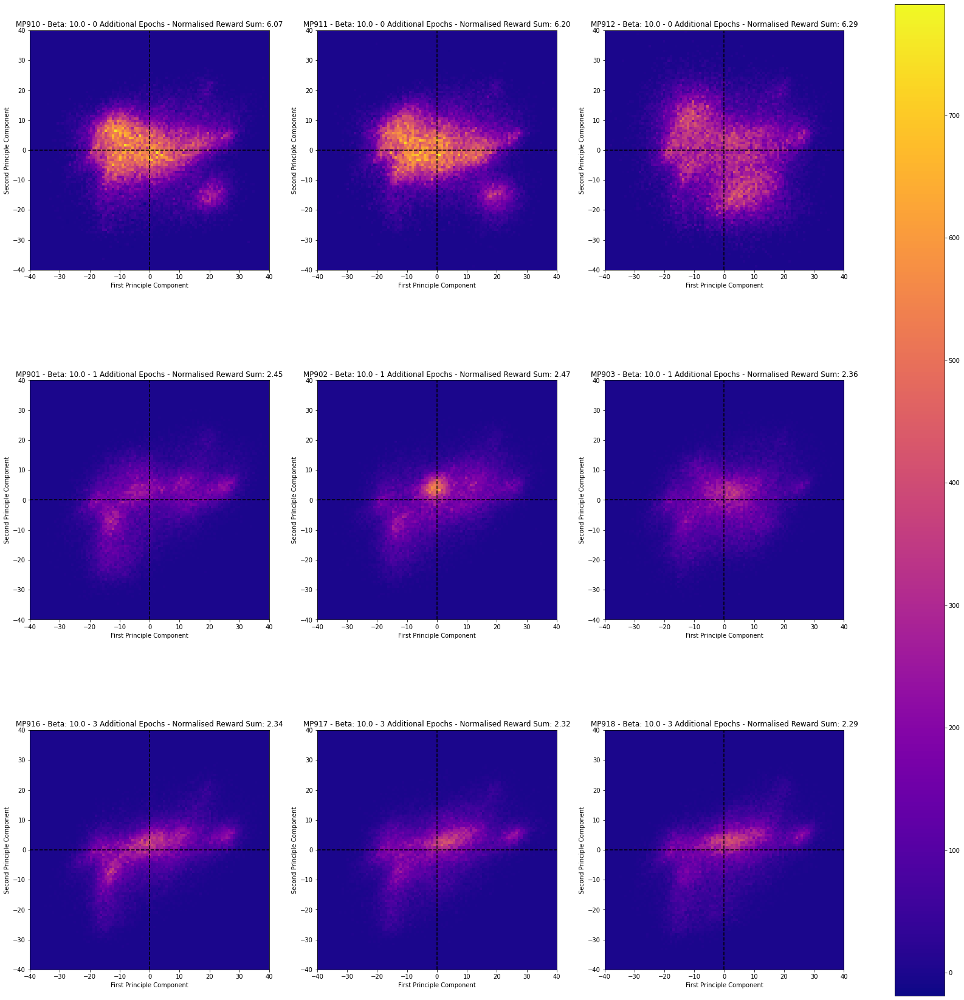

In [ ]:
exp_list_label_set = [
    (("MP910", "MP911", "MP912"), '10.0 - 0 Additional Epochs'),
    (("MP901", "MP902", "MP903"), '10.0 - 1 Additional Epochs'),
    (("MP916", "MP917", "MP918"), '10.0 - 3 Additional Epochs'),
    # (("MP898", "MP899", "MP900"), '0 - Rollout Length 5'),
    # (("MP907", "MP908", "MP909"), '10.0 - Rollout Length 10'),
]
model_pool_unpen_rewards_2dhist(d4rl_mr_training_results, exp_list_label_set, pen_coeff=5.0)

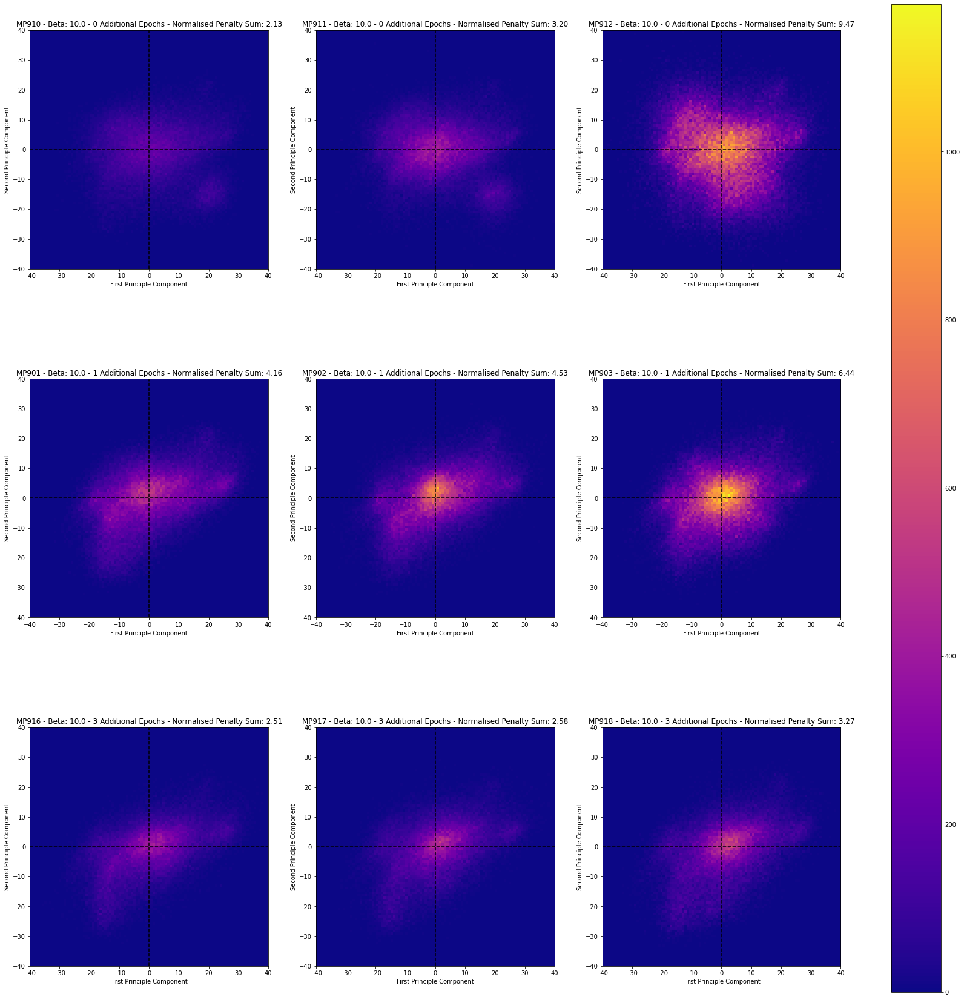

In [ ]:
exp_list_label_set = [
    (("MP910", "MP911", "MP912"), '10.0 - 0 Additional Epochs'),
    (("MP901", "MP902", "MP903"), '10.0 - 1 Additional Epochs'),
    (("MP916", "MP917", "MP918"), '10.0 - 3 Additional Epochs'),
    # (("MP898", "MP899", "MP900"), '0 - Rollout Length 5'),
    # (("MP907", "MP908", "MP909"), '10.0 - Rollout Length 10'),
]
model_pool_penalties_2dhist(d4rl_mr_training_results, exp_list_label_set)

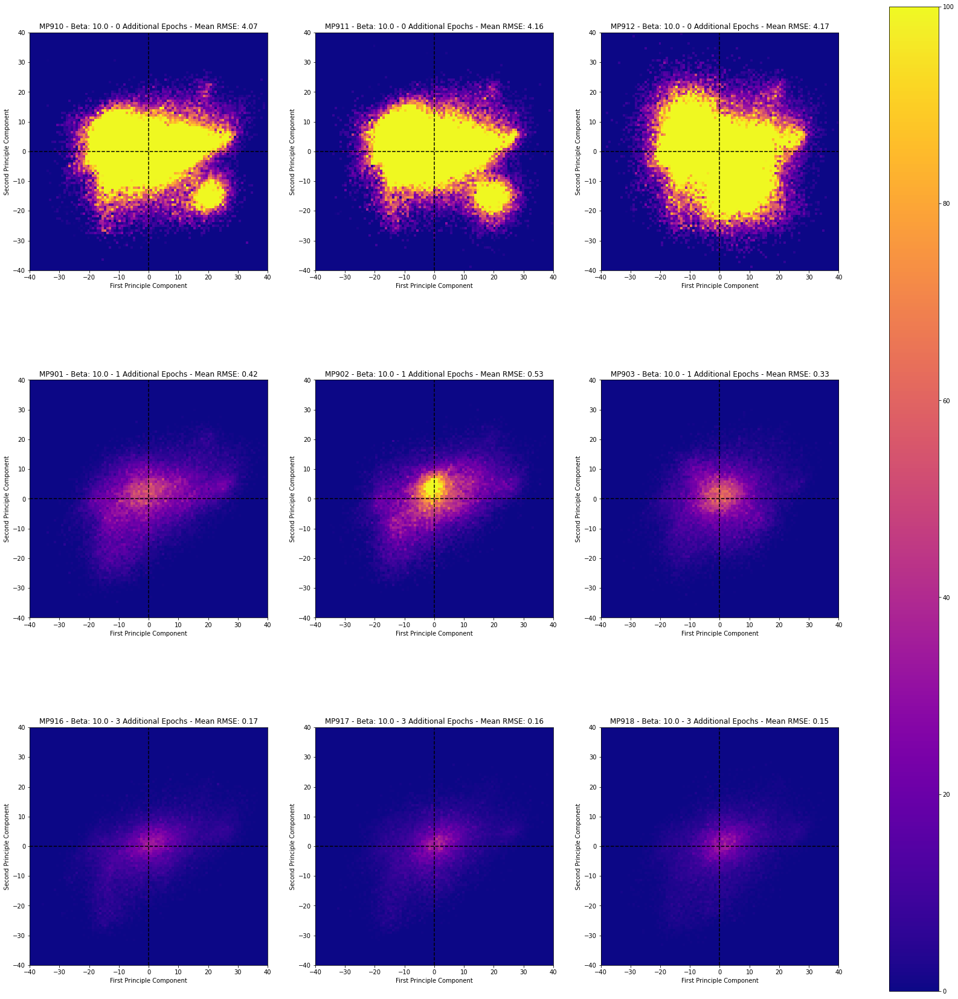

In [ ]:
exp_list_label_set = [
    (("MP910", "MP911", "MP912"), '10.0 - 0 Additional Epochs'),
    (("MP901", "MP902", "MP903"), '10.0 - 1 Additional Epochs'),
    (("MP916", "MP917", "MP918"), '10.0 - 3 Additional Epochs'),
    # (("MP898", "MP899", "MP900"), '0 - Rollout Length 5'),
    # (("MP907", "MP908", "MP909"), '10.0 - Rollout Length 10'),
]
model_pool_rmse_2dhist(d4rl_mr_training_results, exp_list_label_set, vmax=100)